## Installations

In [2]:
!pip install -r requirments.txt
 

## Imports

In [1]:
import pandas as pd
from tqdm import tqdm
import time
import os
import os
import re
from collections import Counter
import pickle
import lichess.api
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import TimeSeriesKMeans
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
from tslearn.clustering import TimeSeriesKMeans, KShape, KernelKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from matplotlib.patches import ConnectionPatch
import matplotlib.pyplot as plt
import numpy as np
import scipy.spatial.distance as dist
from warnings import filterwarnings
from random import sample
from datetime import datetime, timezone
import os
import pandas as pd

from tslearn.utils import to_time_series_dataset
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.clustering import TimeSeriesKMeans, silhouette_score


try:
  from tslearn.clustering import TimeSeriesKMeans
  from tslearn.clustering import silhouette_score
except:
  import sys
  !{sys.executable} -m pip install tslearn
  from tslearn.clustering import TimeSeriesKMeans
  from tslearn.clustering import silhouette_score

import time
from sklearn import metrics
# Avoid showing warnings to keep the notebook outputs clean.
filterwarnings("ignore")

/home/ariel/anaconda3/envs/ml/lib/python3.12/site-packages/tslearn/bases/bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


## Methods

In [2]:
def read_file(file):
    df=pd.read_csv(file)

    return df


def get_all_players(df):
    all_whites=list(set(sorted(df["White"])))
    all_whites=sorted(all_whites)
    all_black=list(set(sorted(df["Black"])))
    all_black=sorted(all_black)
    all_players=list(set(all_whites+all_black))
    return all_players
def get_events_for_player(df,player):
    return Counter(list(df[(df["White"]==player)|(df["Black"]==player)]["Event"]))
def get_games_for_player(df,player):
    return df[(df["White"]==player)|(df["Black"]==player)]

def get_years_for_player(df,player):
    return dict(Counter(list(df[(df["White"]==player)|(df["Black"]==player)]["Year"])))
def get_years_for_player_game(df,player,game):
    return dict(Counter(list(df[((df["White"]==player)|(df["Black"]==player))&(df["Event"]==game)]["Year"])))
def get_players(df):
    w=list(df["White"])
    b=list(df["Black"])
    all=list(set((w+b)))
    return all

def get_games_for_player(df,player):
    player_black_df=df[df["Black"]==player]
    player_black_df=player_black_df[["UTCDate","BlackElo","UTCTime"]]
    player_black_df.rename(columns={'BlackElo':'Elo'},inplace=True)

    player_white_df=df[df["White"]==player]
    player_white_df=player_white_df[["UTCDate","WhiteElo","UTCTime"]]
    player_white_df.rename(columns={'WhiteElo':'Elo'},inplace=True)

    return pd.concat([player_black_df,player_white_df]).sort_values(by='UTCDate')


def date_to_num(date_str):
    # Parse the date string to datetime object
    date_obj = datetime.strptime(date_str, "%Y.%m.%d %H:%M:%S")

    # Convert the datetime object to Unix timestamp (seconds since epoch)
    unix_timestamp = date_obj.replace(tzinfo=timezone.utc).timestamp()
    return unix_timestamp

def get_players_atleast_x_games_type(x,game_type,df):

    df_c=(df[df["Event"]==" Blitz "])
    w=dict(df_c["White"].value_counts())
    b=dict(df_c["Black"].value_counts())
    all={}
    all=w
    for k,v in b.items():
        all[k]=all.get(k,0)+v
    h=[]
    for k,v in w.items():
        if v>200:
            h.append(k)
    len(h)

    #
    df=df[(df["White"].isin(h))|(df["Black"].isin(h))]

    #
    df1=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df1=df1[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    df2=df[(df["White"].isin(h))&(~df["Black"].isin(h))]
    df2=df2[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    #
    df3=df[(~df["White"].isin(h))&(df["Black"].isin(h))]
    df3=df3[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df4=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df4=df4[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df=pd.concat([df1,df2,df3,df4])
    return df



In [100]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr=list(v[(v.index<offset+num_samples)&(v.index>=offset)]["Elo"])
            samples[p]=arr
        except Exception as err:
            print(err)
            pass
        
    for p in list(samples.keys()):
        if len(samples[p])!=num_samples:
            del samples[p]

    
    return samples

def dp(dist_mat):
    """
    Find minimum-cost path through matrix `dist_mat` using dynamic programming.

    The cost of a path is defined as the sum of the matrix entries on that
    path. See the following for details of the algorithm:

    - http://en.wikipedia.org/wiki/Dynamic_time_warping
    - https://www.ee.columbia.edu/~dpwe/resources/matlab/dtw/dp.m

    The notation in the first reference was followed, while Dan Ellis's code
    (second reference) was used to check for correctness. Returns a list of
    path indices and the cost matrix.
    """

    N, M = dist_mat.shape

    # Initialize the cost matrix
    cost_mat = np.zeros((N + 1, M + 1))
    for i in range(1, N + 1):
        cost_mat[i, 0] = np.inf
    for i in range(1, M + 1):
        cost_mat[0, i] = np.inf

    # Fill the cost matrix while keeping traceback information
    traceback_mat = np.zeros((N, M))
    for i in range(N):
        for j in range(M):
            penalty = [
                cost_mat[i, j],      # match (0)
                cost_mat[i, j + 1],  # insertion (1)
                cost_mat[i + 1, j]]  # deletion (2)
            i_penalty = np.argmin(penalty)
            cost_mat[i + 1, j + 1] = dist_mat[i, j] + penalty[i_penalty]
            traceback_mat[i, j] = i_penalty

    # Traceback from bottom right
    i = N - 1
    j = M - 1
    path = [(i, j)]
    while i > 0 or j > 0:
        tb_type = traceback_mat[i, j]
        if tb_type == 0:
            # Match
            i = i - 1
            j = j - 1
        elif tb_type == 1:
            # Insertion
            i = i - 1
        elif tb_type == 2:
            # Deletion
            j = j - 1
        path.append((i, j))

    # Strip infinity edges from cost_mat before returning
    cost_mat = cost_mat[1:, 1:]
    return (path[::-1], cost_mat)


def kmeans_silhoutte(X_train,metric,max_k=10):
    silhoutte_score = []
    for i in range(2,max_k):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred = model.fit_predict(X_train)
        score = silhouette_score(X_train, y_pred, metric=metric)
        silhoutte_score.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    return silhoutte_score

def kmeans_calinski_harabasz(X_train,metric,max_k=10):
    scores = []
    for i in range(2,max_k):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred = model.fit_predict(X_train)
        score = metrics.calinski_harabasz_score(X_train, y_pred)
        scores.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    return scores



def kmeans_wcsss(X_train,metric,max_k=10):
    wcss = []
    for i in range(2,max_k):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        model.fit_predict(X_train)
        print(model.inertia_)
        wcss.append(model.inertia_)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")
    return wcss

def kmeans_cluster(n_clusters,algo,X_train,metric):
    model= TimeSeriesKMeans(n_clusters=n_clusters,
                        metric=metric,
                        n_jobs=-1,
                        random_state=0)
    y_pred = model.fit_predict(X_train)
    model.to_pickle(f"./tsl/models/{algo}.pkl")



    for yi in range(len(np.unique(y_pred))):
      for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)


      plt.plot(model.cluster_centers_[yi].ravel(), "r-")
      plt.xlim(0, X_train.shape[1])
      plt.ylim(-5, 5)
      plt.text(0.55, 0.85,'Cluster %d' % (yi + 1), transform=plt.gca().transAxes)
      plt.title("kmeans")
      plt.tight_layout()
      plt.show();


    for i in range(len(np.unique(y_pred))):
      count = (sum(y_pred == i)/len(y_pred))*100
      print(f"The {count:.2f}% of the observations fall into Cluster {i + 1}")

    return y_pred



In [ ]:
def kmeans_wcss_plot(data,metric,max_k):
    wcss=kmeans_wcsss(data,metric,max_k)
    plt.figure(figsize=(20,10))
    plt.grid()
    plt.plot(range(2,max_k),wcss,marker='o',linestyle='--')
    plt.xlabel('number of clusters')
    plt.ylabel('WCSSS');
    plt.title(f"WCSSS analysis For Optimal K and Optimal Model for {metric} k<={max_k}")


## Get dataset

In [ ]:
!mkdir -p data
!mkdir -p data/fics
!mkdir -p data/fics/raw
!mkdir -p data/fics/dataset_raw
!mkdir -p data/lichess
!mkdir -p data/lichess/raw
!mkdir -p data/lichess/dataset_raw

In [ ]:
# Api key for kaggle
api_token = {"username":"arielzilber","key":"7f0cfa2d136af50998e08583c84cc892"}
!mkdir -p /home/ariel/.kaggle
import json

with open('/home/ariel/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)

In [5]:
!kaggle datasets download arielzilber/chess-games-for-uni-course -p ./data/lichess/dataset_raw

100%|█████████████████████████████████████▉| 1.45G/1.45G [02:31<00:00, 22.4MB/s]
100%|██████████████████████████████████████| 1.45G/1.45G [02:31<00:00, 10.3MB/s]


In [6]:
!kaggle datasets download arielzilber/fcis-standard-2009-to-2023 -p ./data/fics/dataset_raw

fcis-standard-2009-to-2023.zip: Skipping, found more recently modified local copy (use --force to force download)


In [7]:
!ls data/lichess/dataset_raw
!unzip data/lichess/dataset_raw/chess-games-for-uni-course.zip
!mv chess_games.csv data/lichess/dataset_raw/
!ls data/lichess/dataset_raw
!unzip data/fics/dataset_raw/fcis-standard-2009-to-2023.zip
!mv chess-games.csv data/fics/dataset_raw/
!rm data/fics/dataset_raw/fcis-standard-2009-to-2023.zip

chess-games-for-uni-course.zip	players_dict.pkl
Archive:  data/lichess/dataset_raw/chess-games-for-uni-course.zip
  inflating: chess_games.csv         
chess_games.csv  chess-games-for-uni-course.zip  players_dict.pkl


## EDA

#### Win rate

In [14]:
df=read_file("data/fics/dataset_raw/chess-games.csv")
df

,Unnamed: 0.1,Unnamed: 0,Black,BlackClock,BlackElo,BlackIsComp,BlackRD,Date,ECO,Event,...,Result,Round,Site,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,WhiteIsComp
0,0,0,LochChessMonster,0:15:00.000,1745,Yes,25.4,2022.09.12,B12,FICS rated standard game,...,1-0,?,FICS freechess.org,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,NaN
1,1,1,ImBeliever,0:15:00.000,1861,?,34.8,2022.09.12,D02,FICS rated standard game,...,1-0,?,FICS freechess.org,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,NaN
2,2,2,hecklepeckle,0:15:00.000,1619,?,34.2,2022.09.12,C50,FICS rated standard game,...,0-1,?,FICS freechess.org,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,NaN
3,3,3,circum,0:15:00.000,1440,?,28.8,2022.09.12,C10,FICS rated standard game,...,1-0,?,FICS freechess.org,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,NaN
4,4,4,vandi,0:15:00.000,1939,?,29.6,2022.09.12,A00,FICS rated standard game,...,1-0,?,FICS freechess.org,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18492769,2117860,9995,DonatiNair,0:15:00.000,1775,NaN,na,2013.12.12,A02,FICS rated standard game,...,0-1,?,FICS freechess.org,10:19:00,900+0,Romagnoli,0:15:00.000,1691,na,NaN
18492770,2117861,9996,compaqMayank,0:15:00.000,1612,NaN,na,2013.12.12,A45,FICS rated standard game,...,1-0,?,FICS freechess.org,10:01:00,900+0,FredMICH,0:15:00.000,1517,na,NaN
18492771,2117862,9997,mortalaffront,0:13:00.000,1867,NaN,na,2013.12.12,A00,FICS rated standard game,...,1-0,?,FICS freechess.org,10:21:00,780+5,rojmedi,0:13:00.000,1748,na,NaN
18492772,2117863,9998,KarnatakaDon,0:15:00.000,1186,NaN,na,2013.12.12,C25,FICS rated standard game,...,1-0,?,FICS freechess.org,10:23:00,900+0,Divljak,0:15:00.000,1855,na,NaN


In [31]:
df=df.drop(columns=['Unnamed: 0.1', 'Unnamed: 0'])
df["Year"]=df["Date"].apply(lambda r:r.split(".")[0])
df=df.drop(columns="Site")
df=df.drop(columns="Round")
df=df.drop(columns="WhiteIsComp")
df=df.drop(columns="BlackIsComp")
df.to_csv("data/fics/dataset_raw/chess-games-clean.csv")

In [3]:
df=read_file("data/fics/dataset_raw/chess-games-clean.csv")
df

,Unnamed: 0,Black,BlackClock,BlackElo,BlackRD,Date,ECO,Event,FICSGamesDBGameNo,Moves,...,Result,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,EloDiff,RelativeEloDiff,Year
0,0,LochChessMonster,0:15:00.000,1745,25.4,2022.09.12,B12,FICS rated standard game,512494043,e4|c6|d4|d5|e5|Bf5|Nc3|Qb6|a3|Qd8|Nf3|Nd7|h3|N...,...,1-0,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,-143,-4.27,2022
1,1,ImBeliever,0:15:00.000,1861,34.8,2022.09.12,D02,FICS rated standard game,512494029,d4|d5|e3|Bf5|Nf3|f6|Be2|h6|b3|e6|Bb2|Bd6|Nbd2|...,...,1-0,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,40,1.06,2022
2,2,hecklepeckle,0:15:00.000,1619,34.2,2022.09.12,C50,FICS rated standard game,512494019,e4|e5|Nf3|Nc6|Bc4|Bd6|Nc3|Nf6|d3|O-O|a3|Be7|h3...,...,0-1,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,-13,-0.40,2022
3,3,circum,0:15:00.000,1440,28.8,2022.09.12,C10,FICS rated standard game,512494013,e4|e6|Nc3|d5|d4|Be7|e5|Nd7|Nf3|c6|h3|Nb6|Rh2|B...,...,1-0,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,178,5.82,2022
4,4,vandi,0:15:00.000,1939,29.6,2022.09.12,A00,FICS rated standard game,512494009,g4,...,1-0,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,-1,-0.03,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18492769,18492769,DonatiNair,0:15:00.000,1775,na,2013.12.12,A02,FICS rated standard game,347372700,f4|e6|e4|Nc6|Nf3|Nf6|Nc3|d5|exd5|Nxd5|Nxd5|Qxd...,...,0-1,10:19:00,900+0,Romagnoli,0:15:00.000,1691,na,-84,-2.42,2013
18492770,18492770,compaqMayank,0:15:00.000,1612,na,2013.12.12,A45,FICS rated standard game,347372693,d4|Nf6|g3|e6|Bg2|d5|Nc3|b6|Bf4|Bb7|Nb5|Bd6|Nxd...,...,1-0,10:01:00,900+0,FredMICH,0:15:00.000,1517,na,-95,-3.04,2013
18492771,18492771,mortalaffront,0:13:00.000,1867,na,2013.12.12,A00,FICS rated standard game,347372688,g3|Nc6|Bg2|b6|e3|Bb7|Ne2|e5|b3|g6|Bb2|Bg7|O-O|...,...,1-0,10:21:00,780+5,rojmedi,0:13:00.000,1748,na,-119,-3.29,2013
18492772,18492772,KarnatakaDon,0:15:00.000,1186,na,2013.12.12,C25,FICS rated standard game,347372683,e4|e5|Nc3|d6|Bc4|Nf6|d3|h6|a3|a6|Nge2|Be7|O-O|...,...,1-0,10:23:00,900+0,Divljak,0:15:00.000,1855,na,669,22.00,2013


In [32]:
df["EloDiff"] = df["WhiteElo"] - df["BlackElo"]
df["RelativeEloDiff"] = (
    ((df["WhiteElo"] / (df[["WhiteElo", "BlackElo"]].median(axis=1))) - 1.0) * 100.0
).round(2)
display(df.head())

,Black,BlackClock,BlackElo,BlackRD,Date,ECO,Event,FICSGamesDBGameNo,Moves,PlyCount,Result,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,EloDiff,RelativeEloDiff,Year
0,LochChessMonster,0:15:00.000,1745,25.4,2022.09.12,B12,FICS rated standard game,512494043,e4|c6|d4|d5|e5|Bf5|Nc3|Qb6|a3|Qd8|Nf3|Nd7|h3|N...,73,1-0,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,-143,-4.27,2022
1,ImBeliever,0:15:00.000,1861,34.8,2022.09.12,D02,FICS rated standard game,512494029,d4|d5|e3|Bf5|Nf3|f6|Be2|h6|b3|e6|Bb2|Bd6|Nbd2|...,73,1-0,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,40,1.06,2022
2,hecklepeckle,0:15:00.000,1619,34.2,2022.09.12,C50,FICS rated standard game,512494019,e4|e5|Nf3|Nc6|Bc4|Bd6|Nc3|Nf6|d3|O-O|a3|Be7|h3...,66,0-1,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,-13,-0.40,2022
3,circum,0:15:00.000,1440,28.8,2022.09.12,C10,FICS rated standard game,512494013,e4|e6|Nc3|d5|d4|Be7|e5|Nd7|Nf3|c6|h3|Nb6|Rh2|B...,55,1-0,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,178,5.82,2022
4,vandi,0:15:00.000,1939,29.6,2022.09.12,A00,FICS rated standard game,512494009,g4,1,1-0,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,-1,-0.03,2022


In [46]:
def win_rate_by_elo_diff(df,elo_diff):
    try:
        win_freq=Counter(df[df["EloDiff"] > elo_diff]["Result"])
        white_won=win_freq["1-0"]
        draw=win_freq["1/2-1/2"]
        black_won=win_freq["0-1"]
        total=white_won+draw+black_won
        white_wins_proportion = white_won / total
        white_loss_proportion = black_won / total
        draw_proportion = draw / total
        return pd.DataFrame({
            'EloDiff':[elo_diff],
            'TotalGames':[total],
            'WhiteWon':[white_won],
            'WhiteWinsProportion':[white_wins_proportion],
            'WhiteLossProportion':[white_loss_proportion],
            'BlackWon':[black_won],
            'Draw':[draw],
            'DrawProportion':[draw_proportion],
        })
    except Exception as err:
           return pd.DataFrame({
            'EloDiff':[ ],
            'TotalGames':[ ],
            'WhiteWon':[ ],
            'WhiteWinsProportion':[ ],
            'WhiteLossProportion':[ ],
            'BlackWon':[ ],
            'Draw':[ ],
            'DrawProportion':[ ],
        })

In [48]:
frames=[]
for diff in np.arange(600,3601, 200):
    frames.append(win_rate_by_elo_diff(df,diff))

frames_df=pd.concat(frames)
print("-"*50,"Player ratio","-"*50)
display(frames_df)

-------------------------------------------------- Player ratio --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,364666.0,349219.0,0.957641,0.032756,11945.0,3502.0,0.009603
0,800.0,129385.0,126448.0,0.977300,0.016880,2184.0,753.0,0.005820
0,1000.0,47105.0,46552.0,0.988260,0.009235,435.0,118.0,0.002505
0,1200.0,15401.0,15257.0,0.990650,0.007142,110.0,34.0,0.002208
0,1400.0,4020.0,3992.0,0.993035,0.005224,21.0,7.0,0.001741
0,1600.0,676.0,675.0,0.998521,0.001479,1.0,0.0,0.000000
0,1800.0,111.0,110.0,0.990991,0.009009,1.0,0.0,0.000000
0,2000.0,18.0,18.0,1.000000,0.000000,0.0,0.0,0.000000
0,2200.0,3.0,3.0,1.000000,0.000000,0.0,0.0,0.000000


In [53]:

for year in sorted(list(set(df["Year"]))):
    frames=[]
    for diff in np.arange(600,3601, 200):
        frames.append(win_rate_by_elo_diff(df[df["Year"]==year],diff))

    frames_df=pd.concat(frames)
    print("-"*50,"Player ratio for year",year,"-"*50)
    display(frames_df)

-------------------------------------------------- Player ratio for year 2002 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion


-------------------------------------------------- Player ratio for year 2003 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion


-------------------------------------------------- Player ratio for year 2004 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0
0,800.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0


-------------------------------------------------- Player ratio for year 2005 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0
0,800.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0
0,1000.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0
0,1200.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0


-------------------------------------------------- Player ratio for year 2006 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,2.0,0.0,0.0,1.0,2.0,0.0,0.0


-------------------------------------------------- Player ratio for year 2007 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,6.0,4.0,0.666667,0.333333,2.0,0.0,0.0
0,800.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.0


-------------------------------------------------- Player ratio for year 2008 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,63.0,44.0,0.698413,0.301587,19.0,0.0,0.0
0,800.0,17.0,12.0,0.705882,0.294118,5.0,0.0,0.0
0,1000.0,3.0,3.0,1.000000,0.000000,0.0,0.0,0.0
0,1200.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.0


-------------------------------------------------- Player ratio for year 2009 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,27807.0,26443.0,0.950948,0.039702,1104.0,260.0,0.009350
0,800.0,11640.0,11439.0,0.982732,0.012629,147.0,54.0,0.004639
0,1000.0,4270.0,4227.0,0.989930,0.007963,34.0,9.0,0.002108
0,1200.0,1043.0,1030.0,0.987536,0.011505,12.0,1.0,0.000959
0,1400.0,156.0,149.0,0.955128,0.038462,6.0,1.0,0.006410
0,1600.0,8.0,8.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2010 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,31070.0,29516.0,0.949984,0.039363,1223.0,331.0,0.010653
0,800.0,12064.0,11757.0,0.974552,0.017739,214.0,93.0,0.007709
0,1000.0,4079.0,4033.0,0.988723,0.008826,36.0,10.0,0.002452
0,1200.0,816.0,809.0,0.991422,0.008578,7.0,0.0,0.000000
0,1400.0,145.0,144.0,0.993103,0.006897,1.0,0.0,0.000000
0,1600.0,16.0,16.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,3.0,3.0,1.000000,0.000000,0.0,0.0,0.000000
0,2000.0,2.0,2.0,1.000000,0.000000,0.0,0.0,0.000000
0,2200.0,2.0,2.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2011 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,33122.0,31247.0,0.943391,0.043989,1457.0,418.0,0.012620
0,800.0,11152.0,10796.0,0.968077,0.022776,254.0,102.0,0.009146
0,1000.0,3135.0,3079.0,0.982137,0.014673,46.0,10.0,0.003190
0,1200.0,751.0,749.0,0.997337,0.002663,2.0,0.0,0.000000
0,1400.0,200.0,200.0,1.000000,0.000000,0.0,0.0,0.000000
0,1600.0,48.0,48.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,9.0,9.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2012 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,48603.0,46062.0,0.947719,0.040286,1958.0,583.0,0.011995
0,800.0,13166.0,12609.0,0.957694,0.031824,419.0,138.0,0.010482
0,1000.0,3960.0,3899.0,0.984596,0.014394,57.0,4.0,0.001010
0,1200.0,1563.0,1554.0,0.994242,0.005118,8.0,1.0,0.000640
0,1400.0,426.0,423.0,0.992958,0.007042,3.0,0.0,0.000000
0,1600.0,52.0,52.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,3.0,3.0,1.000000,0.000000,0.0,0.0,0.000000
0,2000.0,2.0,2.0,1.000000,0.000000,0.0,0.0,0.000000
0,2200.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2013 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,54548.0,52402.0,0.960659,0.029460,1607.0,539.0,0.009881
0,800.0,19769.0,19348.0,0.978704,0.015782,312.0,109.0,0.005514
0,1000.0,7731.0,7677.0,0.993015,0.006079,47.0,7.0,0.000905
0,1200.0,2984.0,2976.0,0.997319,0.002346,7.0,1.0,0.000335
0,1400.0,719.0,717.0,0.997218,0.002782,2.0,0.0,0.000000
0,1600.0,87.0,87.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,3.0,3.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2014 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,32204.0,31240.0,0.970066,0.024407,786.0,178.0,0.005527
0,800.0,12501.0,12371.0,0.989601,0.008159,102.0,28.0,0.002240
0,1000.0,4506.0,4478.0,0.993786,0.005104,23.0,5.0,0.001110
0,1200.0,1425.0,1420.0,0.996491,0.002105,3.0,2.0,0.001404
0,1400.0,322.0,321.0,0.996894,0.000000,0.0,1.0,0.003106
0,1600.0,27.0,27.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,2.0,2.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2015 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,24680.0,23876.0,0.967423,0.026823,662.0,142.0,0.005754
0,800.0,8764.0,8624.0,0.984026,0.012437,109.0,31.0,0.003537
0,1000.0,2494.0,2472.0,0.991179,0.007217,18.0,4.0,0.001604
0,1200.0,371.0,368.0,0.991914,0.008086,3.0,0.0,0.000000
0,1400.0,29.0,28.0,0.965517,0.034483,1.0,0.0,0.000000
0,1600.0,11.0,11.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2016 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,18882.0,18004.0,0.953501,0.039985,755.0,123.0,0.006514
0,800.0,5697.0,5466.0,0.959452,0.034229,195.0,36.0,0.006319
0,1000.0,1454.0,1393.0,0.958047,0.037139,54.0,7.0,0.004814
0,1200.0,353.0,336.0,0.951841,0.048159,17.0,0.0,0.000000
0,1400.0,76.0,76.0,1.000000,0.000000,0.0,0.0,0.000000
0,1600.0,13.0,13.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2017 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,18315.0,17722.0,0.967622,0.025116,460.0,133.0,0.007262
0,800.0,6926.0,6820.0,0.984695,0.011406,79.0,27.0,0.003898
0,1000.0,2449.0,2426.0,0.990608,0.006533,16.0,7.0,0.002858
0,1200.0,770.0,758.0,0.984416,0.009091,7.0,5.0,0.006494
0,1400.0,122.0,122.0,1.000000,0.000000,0.0,0.0,0.000000
0,1600.0,15.0,15.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,2.0,2.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2018 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,21346.0,20724.0,0.970861,0.021034,449.0,173.0,0.008105
0,800.0,8792.0,8699.0,0.989422,0.008076,71.0,22.0,0.002502
0,1000.0,4303.0,4273.0,0.993028,0.005578,24.0,6.0,0.001394
0,1200.0,1638.0,1626.0,0.992674,0.006716,11.0,1.0,0.000611
0,1400.0,423.0,421.0,0.995272,0.002364,1.0,1.0,0.002364
0,1600.0,63.0,63.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2019 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,16138.0,15585.0,0.965733,0.026893,434.0,119.0,0.007374
0,800.0,6263.0,6137.0,0.979882,0.017883,112.0,14.0,0.002235
0,1000.0,2469.0,2447.0,0.991090,0.007290,18.0,4.0,0.001620
0,1200.0,759.0,752.0,0.990777,0.006588,5.0,2.0,0.002635
0,1400.0,180.0,176.0,0.977778,0.011111,2.0,2.0,0.011111
0,1600.0,26.0,26.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,2.0,2.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2020 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,12700.0,12230.0,0.962992,0.026457,336.0,134.0,0.010551
0,800.0,4822.0,4752.0,0.985483,0.009540,46.0,24.0,0.004977
0,1000.0,2540.0,2509.0,0.987795,0.006299,16.0,15.0,0.005906
0,1200.0,1250.0,1232.0,0.985600,0.007200,9.0,9.0,0.007200
0,1400.0,400.0,399.0,0.997500,0.002500,1.0,0.0,0.000000
0,1600.0,71.0,71.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,10.0,10.0,1.000000,0.000000,0.0,0.0,0.000000
0,2000.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2021 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,10720.0,10272.0,0.958209,0.026679,286.0,162.0,0.015112
0,800.0,3763.0,3678.0,0.977412,0.011959,45.0,40.0,0.010630
0,1000.0,1720.0,1692.0,0.983721,0.009302,16.0,12.0,0.006977
0,1200.0,908.0,895.0,0.985683,0.006608,6.0,7.0,0.007709
0,1400.0,440.0,438.0,0.995455,0.004545,2.0,0.0,0.000000
0,1600.0,74.0,73.0,0.986486,0.013514,1.0,0.0,0.000000
0,1800.0,10.0,9.0,0.900000,0.100000,1.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2022 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,6895.0,6615.0,0.959391,0.026396,182.0,98.0,0.014213
0,800.0,2328.0,2277.0,0.978093,0.014175,33.0,18.0,0.007732
0,1000.0,1261.0,1241.0,0.984140,0.009516,12.0,8.0,0.006344
0,1200.0,493.0,490.0,0.993915,0.006085,3.0,0.0,0.000000
0,1400.0,232.0,231.0,0.995690,0.004310,1.0,0.0,0.000000
0,1600.0,99.0,99.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,35.0,35.0,1.000000,0.000000,0.0,0.0,0.000000
0,2000.0,12.0,12.0,1.000000,0.000000,0.0,0.0,0.000000


-------------------------------------------------- Player ratio for year 2023 --------------------------------------------------


,EloDiff,TotalGames,WhiteWon,WhiteWinsProportion,WhiteLossProportion,BlackWon,Draw,DrawProportion
0,600.0,7562.0,7230.0,0.956096,0.029490,223.0,109.0,0.014414
0,800.0,1718.0,1660.0,0.966240,0.023865,41.0,17.0,0.009895
0,1000.0,730.0,702.0,0.961644,0.024658,18.0,10.0,0.013699
0,1200.0,275.0,260.0,0.945455,0.036364,10.0,5.0,0.018182
0,1400.0,150.0,147.0,0.980000,0.006667,1.0,2.0,0.013333
0,1600.0,66.0,66.0,1.000000,0.000000,0.0,0.0,0.000000
0,1800.0,30.0,30.0,1.000000,0.000000,0.0,0.0,0.000000
0,2000.0,1.0,1.0,1.000000,0.000000,0.0,0.0,0.000000


In [45]:
win_freq2=Counter(df[df["EloDiff"] > 20]["Result"])
white_won2=win_freq2["1-0"]
draw2=win_freq2["1/2-1/2"]
black_won2=win_freq2["0-1"]
total2=white_won2+draw2+black_won2
white_wins_proportion2 = white_won2 / total2
white_loss_proportion2 = black_won2 / total2
draw_proportion2 = draw2 / total2
print(
    f"Out of {total2} games:\n  White won {white_won2} games "
    f"({white_wins_proportion2:.2%}).\n  White lost {black_won2} games "
    f"({white_loss_proportion2:.2%}).\n"
    f"  White draw {draw2} games ({draw_proportion2:.2%}).  "
)

Out of 8139709 games:
  White won 5506728 games (67.65%).
  White lost 2279695 games (28.01%).
  White draw 353286 games (4.34%).  


In [21]:
win_freq2=Counter(df[df["EloDiff"] > 20]["Result"])
white_won2=win_freq2["1-0"]
draw2=win_freq2["1/2-1/2"]
black_won2=win_freq2["0-1"]
total2=white_won2+draw2+black_won2
white_wins_proportion2 = white_won2 / total2
white_loss_proportion2 = black_won2 / total2
draw_proportion2 = draw2 / total2
print(
    f"Out of {total2} games:\n  White won {white_won2} games "
    f"({white_wins_proportion2:.2%}).\n  White lost {black_won2} games "
    f"({white_loss_proportion2:.2%}).\n"
    f"  White draw {draw2} games ({draw_proportion2:.2%}).  "
)

Out of 8139709 games:
  White won 5506728 games (67.65%).
  White lost 2279695 games (28.01%).
  White draw 353286 games (4.34%).  


#### Elo distributions

In [22]:
def get_elo_freq(df):
    freq_elo_black=Counter(list(df["BlackElo"]))
    freq_elo_white=Counter(list(df["WhiteElo"]))
    both={}
    for k,v in freq_elo_black.items():
        both[k]=v

    for k,v in freq_elo_white.items():
        both[k]=both.get(k,0)+v
    keys=list(both.keys())
    vals=list(both.values())
    frame=pd.DataFrame({
        'Elo':keys,
        'Count':vals,
    }).sort_values('Count',ascending=True)
    return frame

Text(0, 0.5, 'Count')

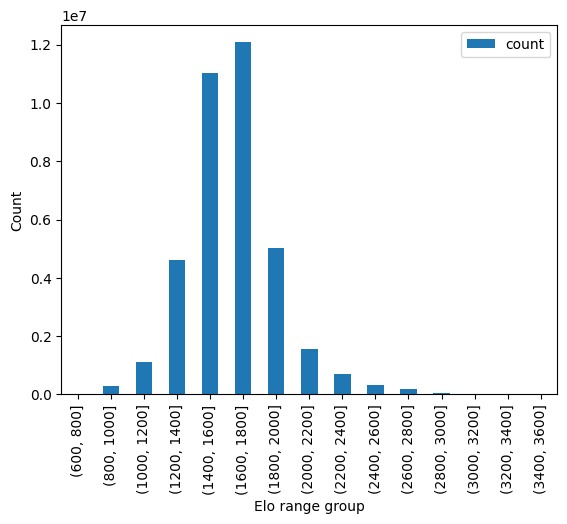

In [23]:
elo_freq=get_elo_freq(df)
elo_freq=elo_freq[["Elo","Count"]]
rating_bins = np.arange(600,3601, 200)
cuts=pd.cut(elo_freq["Elo"], bins=rating_bins)
elo_freq["group"]=cuts
groups=elo_freq.groupby('group').sum(["count"]).drop(columns="Elo")["Count"]
elo_freq=pd.DataFrame.from_dict({'group':list(groups.index.astype(str)),'count':list(groups.values)})
ax=elo_freq.plot(kind='bar',x='group',y='count')
ax.set_xlabel("Elo range group")
ax.set_ylabel("Count")

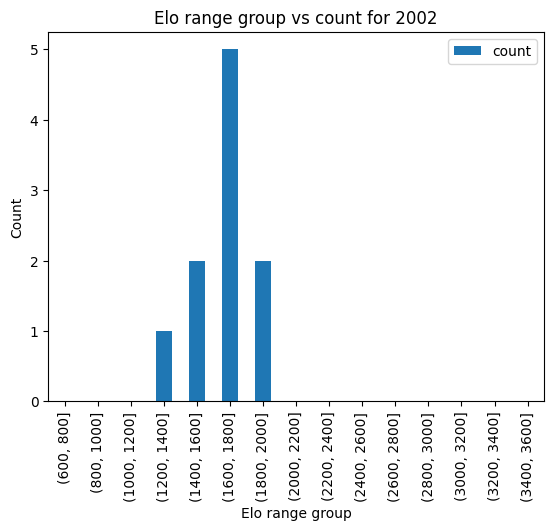

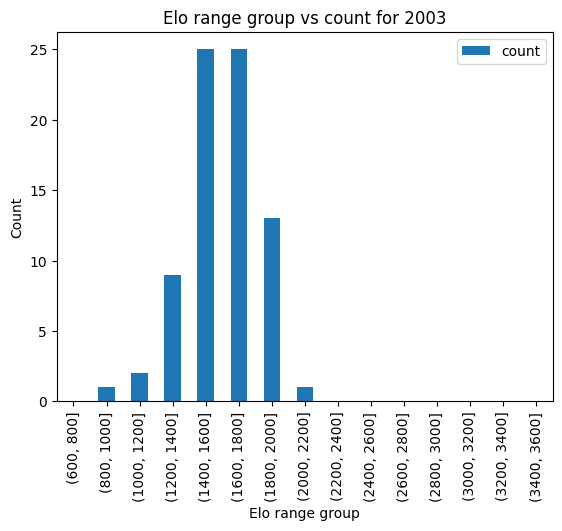

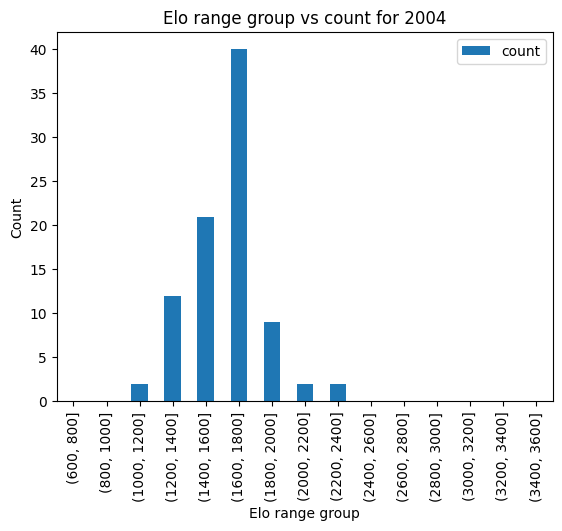

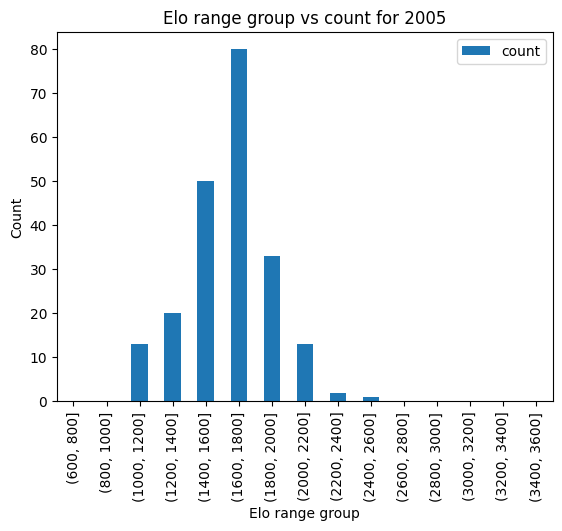

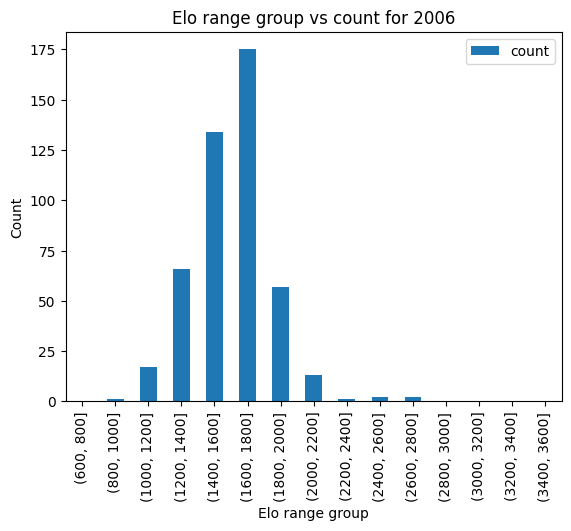

...

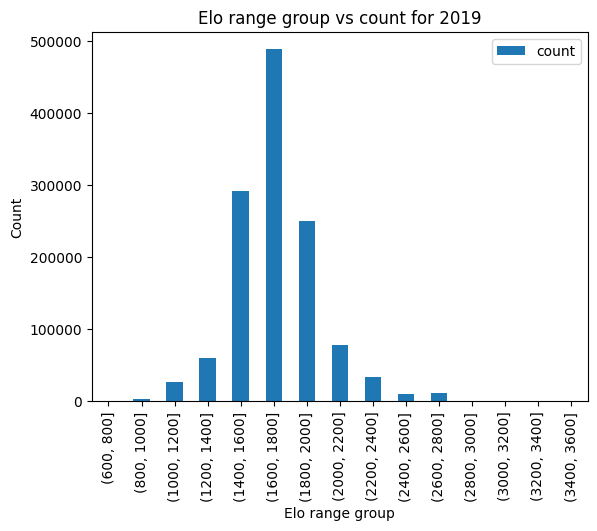

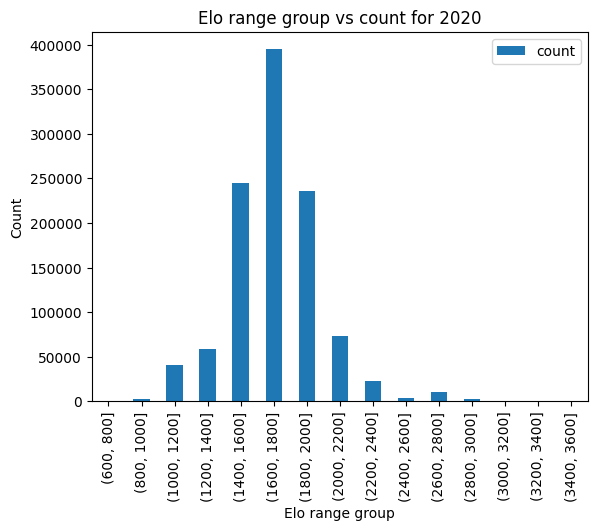

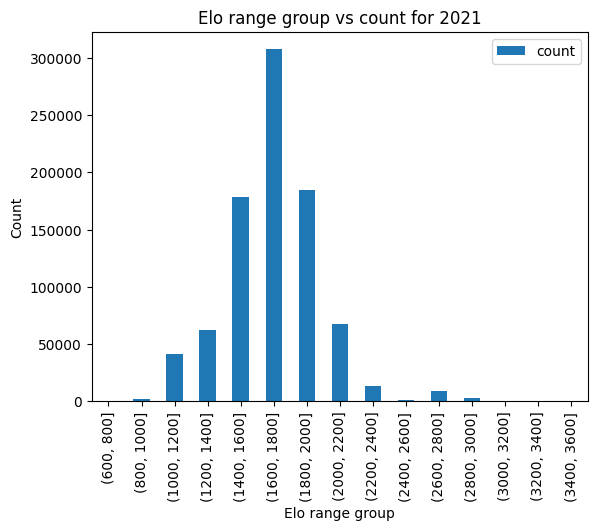

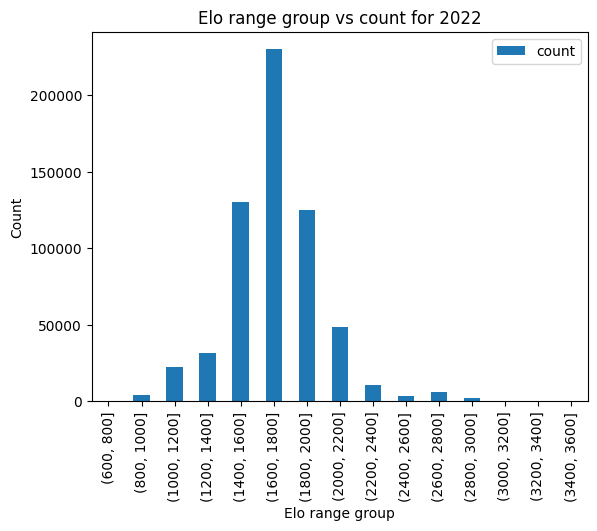

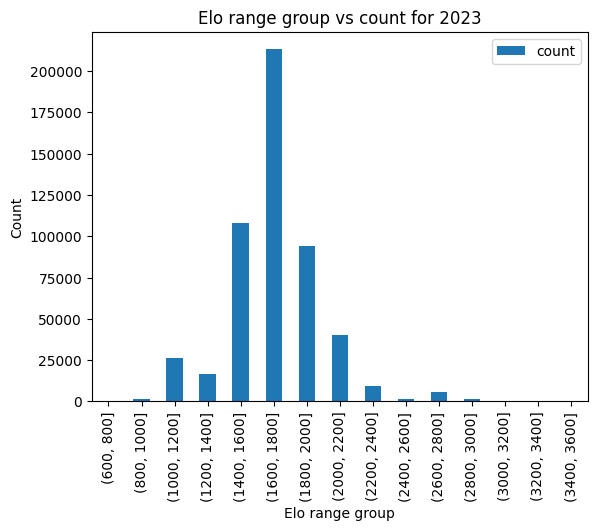

In [55]:
for year in sorted(list(set(df["Year"]))):
    elo_freq=get_elo_freq(df[df["Year"]==year])
    elo_freq=elo_freq[["Elo","Count"]]
    rating_bins = np.arange(600,3601, 200)
    cuts=pd.cut(elo_freq["Elo"], bins=rating_bins)
    elo_freq["group"]=cuts
    groups=elo_freq.groupby('group').sum(["count"]).drop(columns="Elo")["Count"]
    elo_freq=pd.DataFrame.from_dict({'group':list(groups.index.astype(str)),'count':list(groups.values)})
    ax=elo_freq.plot(kind='bar',x='group',y='count')
    ax.set_title(f"Elo range group vs count for {year}")
    ax.set_xlabel("Elo range group")
    ax.set_ylabel("Count")

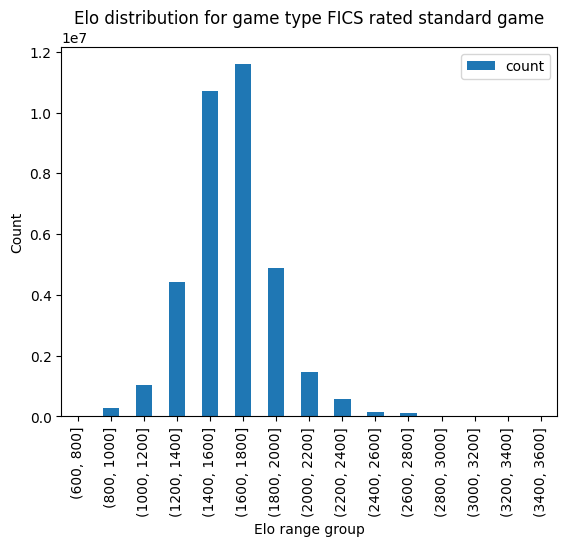

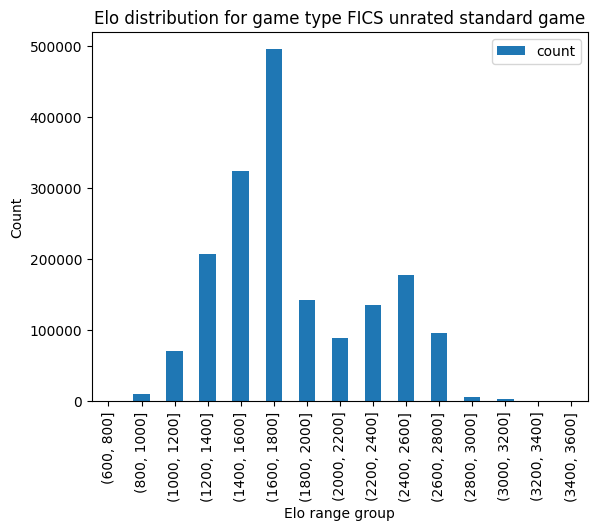

In [24]:
events=list(set(list(df["Event"])))


for e in events:
    df_e=df[df["Event"]==e]

    elo_freq=get_elo_freq(df_e)
    elo_freq=elo_freq[["Elo","Count"]]
    rating_bins = np.arange(600,3601, 200)
    cuts=pd.cut(elo_freq["Elo"], bins=rating_bins)
    elo_freq["group"]=cuts
    groups=elo_freq.groupby('group').sum(["count"]).drop(columns="Elo")["Count"]
    elo_freq=pd.DataFrame.from_dict({'group':list(groups.index.astype(str)),'count':list(groups.values)})
    ax=elo_freq.plot(kind='bar',x='group',y='count')
    ax.set_title(f"Elo range group vs count for {year} ")
    ax.set_xlabel("Elo range group")
    ax.set_ylabel("Count")
    ax.set_title(f"Elo distribution for game type {e}")

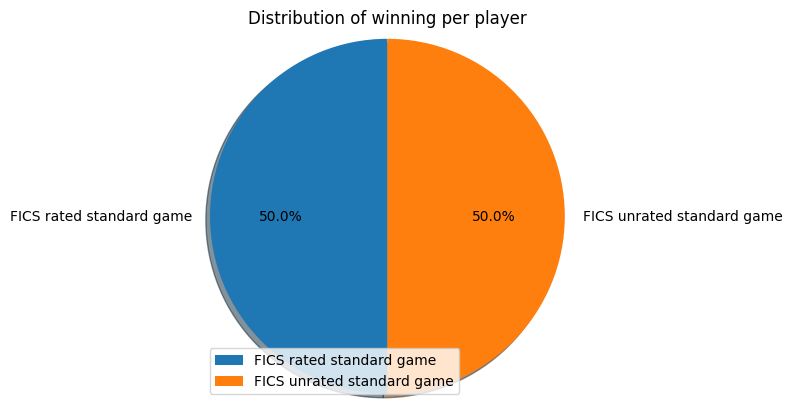

In [25]:
import matplotlib.pyplot as plt


by_event={e:len(df["Event"]==e) for e in list(set(list(df["Event"])))}
# defining labels
activities = list(by_event.keys())

# portion covered by each label
slices = list(by_event.values())

# color for each label
colors = ['r', 'y', 'g', 'b']

# plotting the pie chart
plt.pie(slices, labels = activities,
        startangle=90, shadow = True,
        radius = 1.2, autopct = '%1.1f%%')

# plotting legend
plt.legend()
plt.title("Distribution of winning per player")


# showing the plot
plt.show()


#### Number of games distributions

<BarContainer object of 7 artists>

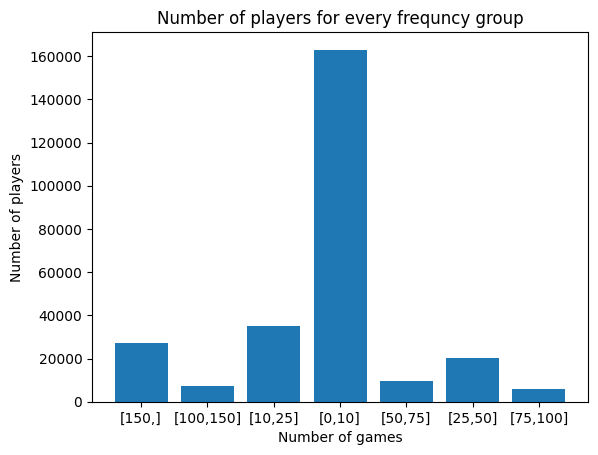

In [26]:
from collections import Counter
white_freq=Counter(list(df["White"]))
black_freq=Counter(list(df["Black"]))
all_freq=white_freq

for k,v in black_freq.items():
    all_freq[k]=all_freq.get(k,0)+v

count_freq={}
for k,v in all_freq.items():
    if v <=10:
        count_freq["[0,10]"]=count_freq.get("[0,10]",0)+1
    elif v <=25:
        count_freq["[10,25]"]=count_freq.get("[10,25]",0)+1
    elif v <=50:
        count_freq["[25,50]"]=count_freq.get("[25,50]",0)+1
    elif v <=75:
        count_freq["[50,75]"]=count_freq.get("[50,75]",0)+1
    elif v <=100:
        count_freq["[75,100]"]=count_freq.get("[75,100]",0)+1
    elif v <=150:
        count_freq["[100,150]"]=count_freq.get("[100,150]",0)+1
    else:
        count_freq["[150,]"]=count_freq.get("[150,]",0)+1

x = list(count_freq.keys())
y = list(count_freq.values())
plt.xlabel('Number of games')
plt.ylabel('Number of players')
plt.title('Number of players for every frequncy group')
plt.bar( x, y)


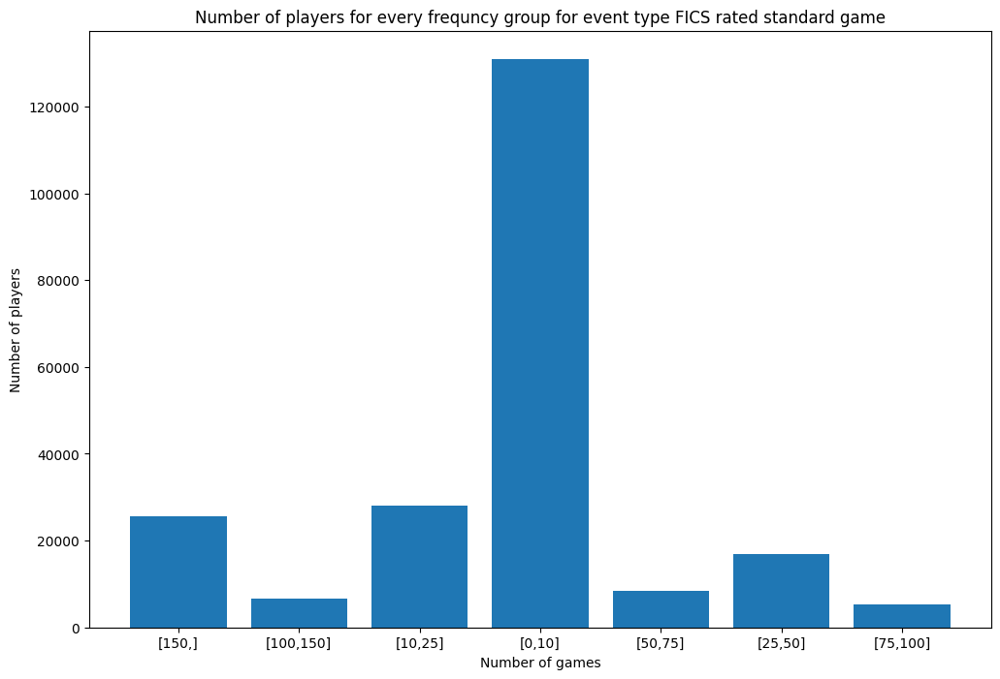

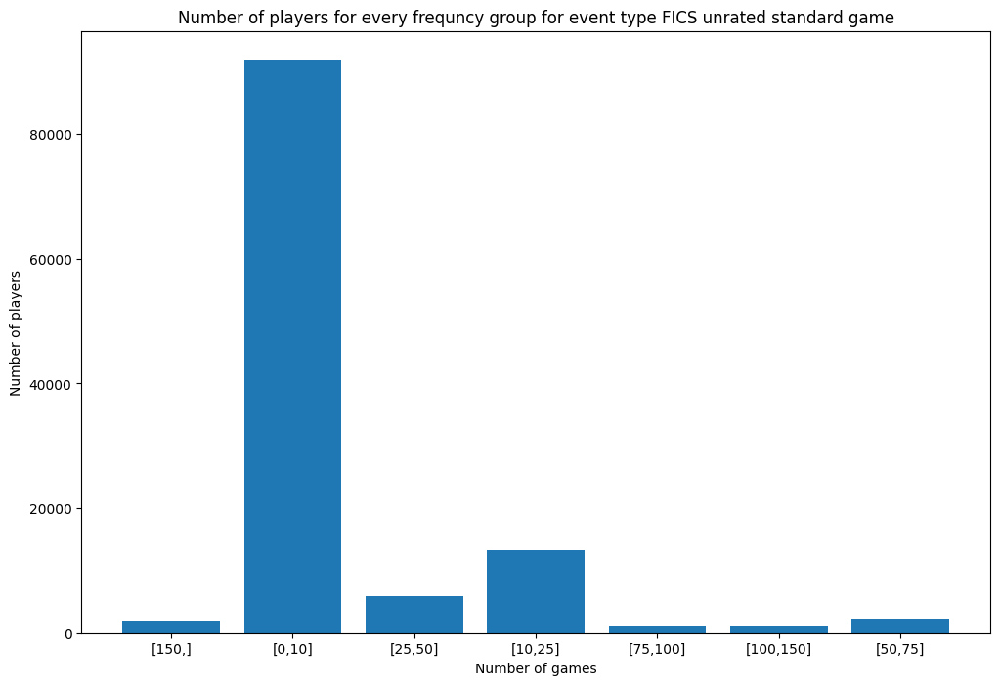

In [28]:
from collections import Counter

events=list(set(list(df["Event"])))


for e in events:
    df_e=df[df["Event"]==e]
    white_freq=Counter(list(df_e["White"]))
    black_freq=Counter(list(df_e["Black"]))
    all_freq=white_freq

    for k,v in black_freq.items():
        all_freq[k]=all_freq.get(k,0)+v

    count_freq={}
    for k,v in all_freq.items():
        if v <=10:
            count_freq["[0,10]"]=count_freq.get("[0,10]",0)+1
        elif v <=25:
            count_freq["[10,25]"]=count_freq.get("[10,25]",0)+1
        elif v <=50:
            count_freq["[25,50]"]=count_freq.get("[25,50]",0)+1
        elif v <=75:
            count_freq["[50,75]"]=count_freq.get("[50,75]",0)+1
        elif v <=100:
            count_freq["[75,100]"]=count_freq.get("[75,100]",0)+1
        elif v <=150:
            count_freq["[100,150]"]=count_freq.get("[100,150]",0)+1
        else:
            count_freq["[150,]"]=count_freq.get("[150,]",0)+1
    plt.figure(figsize=(12, 8))
    x = list(count_freq.keys())
    y = list(count_freq.values())
    plt.xlabel('Number of games')
    plt.ylabel('Number of players')
    plt.title(f'Number of players for every frequncy group for event type {e}')
    plt.bar( x, y)


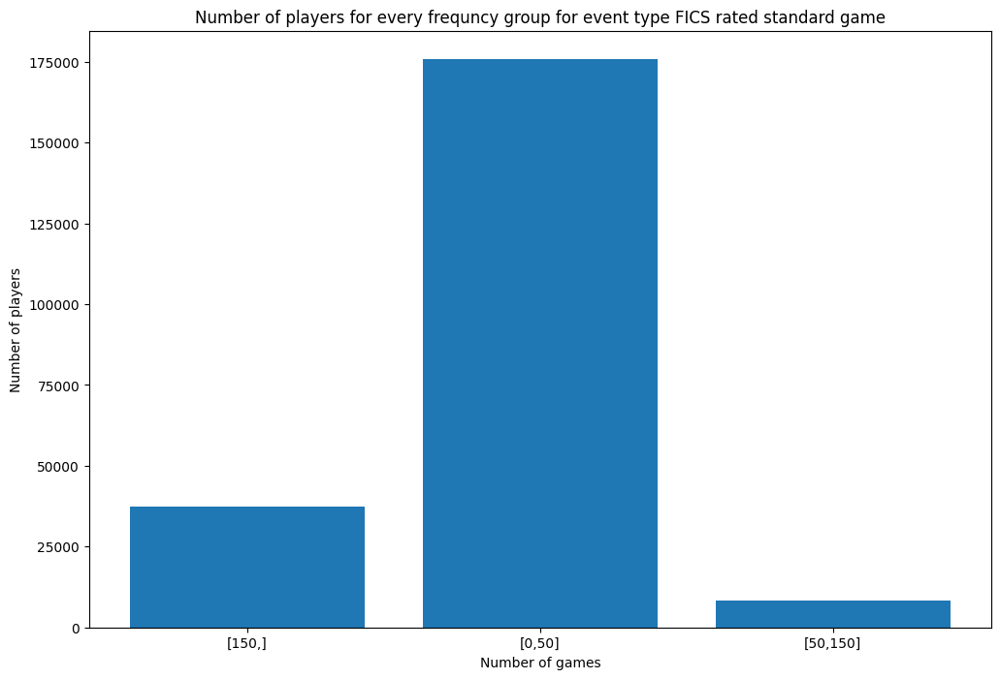

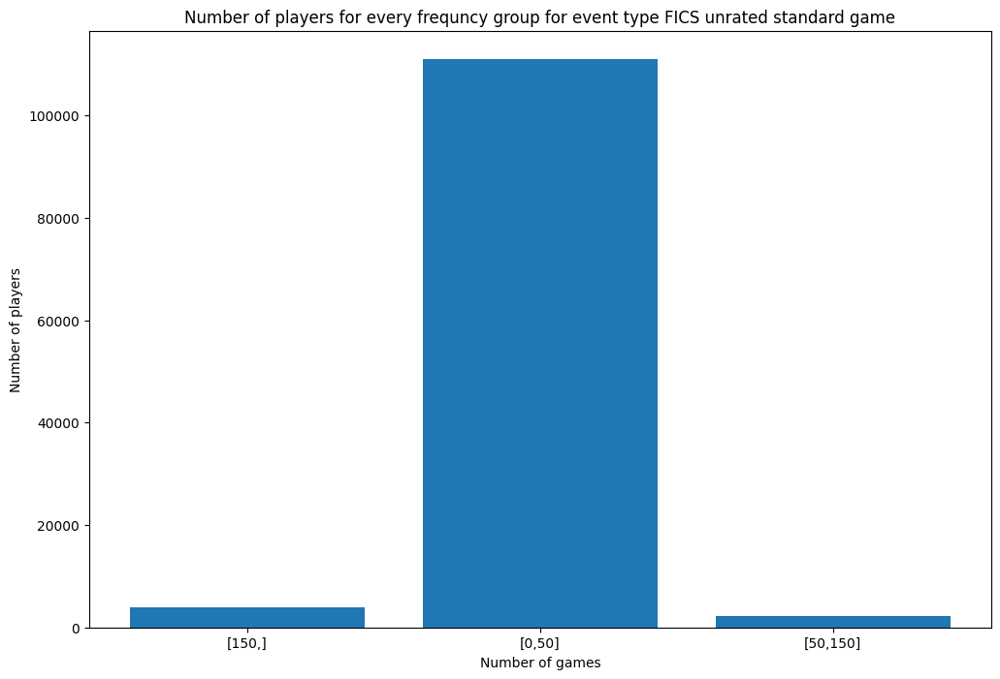

In [27]:
from collections import Counter

events=list(set(list(df["Event"])))


for e in events:
    df_e=df[df["Event"]==e]
    white_freq=Counter(list(df_e["White"]))
    black_freq=Counter(list(df_e["Black"]))
    all_freq=white_freq

    for k,v in black_freq.items():
        all_freq[k]=all_freq.get(k,0)+v

    count_freq={}
    for k,v in all_freq.items():
        if v <=50:
            count_freq["[0,50]"]=count_freq.get("[0,50]",0)+1
        elif v <=75:
            count_freq["[50,150]"]=count_freq.get("[50,150]",0)+1
        else:
            count_freq["[150,]"]=count_freq.get("[150,]",0)+1
    plt.figure(figsize=(12, 8))
    x = list(count_freq.keys())
    y = list(count_freq.values())
    plt.xlabel('Number of games')
    plt.ylabel('Number of players')
    plt.title(f'Number of players for every frequncy group for event type {e}')
    plt.bar( x, y)


### Choose game type to work with

In [4]:
df=df[df["Event"]=="FICS rated standard game"]
df=df.drop(columns="Event")
df.to_csv("data/fics/dataset_raw/chess-games-rated-standard.csv")

In [3]:
df=read_file("data/fics/dataset_raw/chess-games-rated-standard.csv")

In [7]:
# df=df.drop(columns=["Unnamed: 0.1","Unnamed: 0"])
df.to_csv("data/fics/dataset_raw/chess-games-rated-standard.csv")

In [ ]:
df=df.drop(columns="Event")
df=df.drop(columns="Site")
df=df.drop(columns="Round")
df=df.drop(columns="WhiteIsComp")
df=df.drop(columns="BlackIsComp")
df.to_csv("data/fics/dataset_raw/chess-games-rated-clean.csv")


In [3]:
df=read_file("data/fics/dataset_raw/chess-games-rated-clean.csv")

FileNotFoundError: [Errno 2] No such file or directory: 'data/fics/dataset_raw/chess-games-rated-clean.csv'

In [9]:
w=dict(df["White"].value_counts())
b=dict(df["Black"].value_counts())
print()
all={}

all=w

for k,v in b.items():
    all[k]=all.get(k,0)+v
h=[]
for k,v in w.items():
    if v>200:
        h.append(k)
len(h)

21374

In [9]:
df=df[(df["White"].isin(h))|(df["Black"].isin(h))]
df.to_csv("data/fics/dataset_raw/chess-games-rated-standard-filtered.csv")


In [4]:
df=read_file("data/fics/dataset_raw/chess-games-rated-standard-filtered.csv")
df

,Unnamed: 0,Black,BlackClock,BlackElo,BlackRD,Date,ECO,FICSGamesDBGameNo,Moves,PlyCount,Result,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,EloDiff,RelativeEloDiff,Year
0,0,LochChessMonster,0:15:00.000,1745,25.4,2022.09.12,B12,512494043,e4|c6|d4|d5|e5|Bf5|Nc3|Qb6|a3|Qd8|Nf3|Nd7|h3|N...,73,1-0,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,-143,-4.27,2022
1,1,ImBeliever,0:15:00.000,1861,34.8,2022.09.12,D02,512494029,d4|d5|e3|Bf5|Nf3|f6|Be2|h6|b3|e6|Bb2|Bd6|Nbd2|...,73,1-0,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,40,1.06,2022
2,2,hecklepeckle,0:15:00.000,1619,34.2,2022.09.12,C50,512494019,e4|e5|Nf3|Nc6|Bc4|Bd6|Nc3|Nf6|d3|O-O|a3|Be7|h3...,66,0-1,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,-13,-0.40,2022
3,3,circum,0:15:00.000,1440,28.8,2022.09.12,C10,512494013,e4|e6|Nc3|d5|d4|Be7|e5|Nd7|Nf3|c6|h3|Nb6|Rh2|B...,55,1-0,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,178,5.82,2022
4,4,vandi,0:15:00.000,1939,29.6,2022.09.12,A00,512494009,g4,1,1-0,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,-1,-0.03,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17287423,17613133,IrishPirate,0:15:00.000,1861,na,2013.12.12,B02,347372701,e4|d5|exd5|Nf6|Nc3|Nxd5|Bc4|e6|Nf3|Nxc3|bxc3|B...,55,0-1,10:25:00,900+0,CaptainDeflecto,0:15:00.000,1446,na,-415,-12.55,2013
17287424,17613134,DonatiNair,0:15:00.000,1775,na,2013.12.12,A02,347372700,f4|e6|e4|Nc6|Nf3|Nf6|Nc3|d5|exd5|Nxd5|Nxd5|Qxd...,44,0-1,10:19:00,900+0,Romagnoli,0:15:00.000,1691,na,-84,-2.42,2013
17287425,17613135,compaqMayank,0:15:00.000,1612,na,2013.12.12,A45,347372693,d4|Nf6|g3|e6|Bg2|d5|Nc3|b6|Bf4|Bb7|Nb5|Bd6|Nxd...,85,1-0,10:01:00,900+0,FredMICH,0:15:00.000,1517,na,-95,-3.04,2013
17287426,17613136,mortalaffront,0:13:00.000,1867,na,2013.12.12,A00,347372688,g3|Nc6|Bg2|b6|e3|Bb7|Ne2|e5|b3|g6|Bb2|Bg7|O-O|...,43,1-0,10:21:00,780+5,rojmedi,0:13:00.000,1748,na,-119,-3.29,2013


In [5]:
df=df.drop(columns="FICSGamesDBGameNo")

In [6]:
df

,Unnamed: 0,Black,BlackClock,BlackElo,BlackRD,Date,ECO,Moves,PlyCount,Result,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,EloDiff,RelativeEloDiff,Year
0,0,LochChessMonster,0:15:00.000,1745,25.4,2022.09.12,B12,e4|c6|d4|d5|e5|Bf5|Nc3|Qb6|a3|Qd8|Nf3|Nd7|h3|N...,73,1-0,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,-143,-4.27,2022
1,1,ImBeliever,0:15:00.000,1861,34.8,2022.09.12,D02,d4|d5|e3|Bf5|Nf3|f6|Be2|h6|b3|e6|Bb2|Bd6|Nbd2|...,73,1-0,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,40,1.06,2022
2,2,hecklepeckle,0:15:00.000,1619,34.2,2022.09.12,C50,e4|e5|Nf3|Nc6|Bc4|Bd6|Nc3|Nf6|d3|O-O|a3|Be7|h3...,66,0-1,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,-13,-0.40,2022
3,3,circum,0:15:00.000,1440,28.8,2022.09.12,C10,e4|e6|Nc3|d5|d4|Be7|e5|Nd7|Nf3|c6|h3|Nb6|Rh2|B...,55,1-0,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,178,5.82,2022
4,4,vandi,0:15:00.000,1939,29.6,2022.09.12,A00,g4,1,1-0,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,-1,-0.03,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17287423,17613133,IrishPirate,0:15:00.000,1861,na,2013.12.12,B02,e4|d5|exd5|Nf6|Nc3|Nxd5|Bc4|e6|Nf3|Nxc3|bxc3|B...,55,0-1,10:25:00,900+0,CaptainDeflecto,0:15:00.000,1446,na,-415,-12.55,2013
17287424,17613134,DonatiNair,0:15:00.000,1775,na,2013.12.12,A02,f4|e6|e4|Nc6|Nf3|Nf6|Nc3|d5|exd5|Nxd5|Nxd5|Qxd...,44,0-1,10:19:00,900+0,Romagnoli,0:15:00.000,1691,na,-84,-2.42,2013
17287425,17613135,compaqMayank,0:15:00.000,1612,na,2013.12.12,A45,d4|Nf6|g3|e6|Bg2|d5|Nc3|b6|Bf4|Bb7|Nb5|Bd6|Nxd...,85,1-0,10:01:00,900+0,FredMICH,0:15:00.000,1517,na,-95,-3.04,2013
17287426,17613136,mortalaffront,0:13:00.000,1867,na,2013.12.12,A00,g3|Nc6|Bg2|b6|e3|Bb7|Ne2|e5|b3|g6|Bb2|Bg7|O-O|...,43,1-0,10:21:00,780+5,rojmedi,0:13:00.000,1748,na,-119,-3.29,2013


In [7]:
df.to_csv("data/fics/dataset_raw/chess-games-rated-clean-filtered.csv")


In [10]:
#
try:
    df=df[(df["White"].isin(h))|(df["Black"].isin(h))]

    #
    df1=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df1=df1[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    df2=df[(df["White"].isin(h))&(~df["Black"].isin(h))]
    df2=df2[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    #
    df3=df[(~df["White"].isin(h))&(df["Black"].isin(h))]
    df3=df3[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df4=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df4=df4[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df=pd.concat([df1,df2,df3,df4])
except Exception as err:
    df=df[(df["White"].isin(h))|(df["Black"].isin(h))]

    #
    df1=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df1=df1[["White","WhiteElo","Date","Time"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    df2=df[(df["White"].isin(h))&(~df["Black"].isin(h))]
    df2=df2[["White","WhiteElo","Date","Time"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    #
    df3=df[(~df["White"].isin(h))&(df["Black"].isin(h))]
    df3=df3[["Black","BlackElo","Date","Time"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df4=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df4=df4[["Black","BlackElo","Date","Time"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df=pd.concat([df1,df2,df3,df4])


In [11]:
df.to_csv("data/fics/dataset_raw/chess-games-rated-clean-filtered.csv")


In [12]:
df["Year"]=df["Date"].apply(lambda r:int(r.split(".")[0]))
df["Month"]=df["Date"].apply(lambda r:int(r.split(".")[1]))
df["Day"]=df["Date"].apply(lambda r:int(r.split(".")[2]))
df=df[df["Year"]>=2015]
# df=df[df["Year"]<=2019]
df.to_csv("data/fics/dataset_raw/chess-games-rated-clean-filtered-2015-2023.csv")

In [14]:
players_freq=dict(df["Player"].value_counts())
players=[]

for k,v in players_freq.items():
    if v>200:
        players.append(k)
        
len(players)

6994

In [19]:
df=read_file("data/fics/dataset_raw/chess-games-rated-clean-filtered-2015-2023.csv")


In [15]:
df=df[(df["Player"].isin(players))]
df.to_csv("data/fics/dataset_raw/chess-games-rated-clean-filtered-2015-2023.csv")


In [16]:
atleast_1_year=[]
for p in tqdm(players):
    if len(list(set(df[df["Player"]==p]["Year"])))>1:
        atleast_1_year.append(p)
players=atleast_1_year
df=df[(df["Player"].isin(players))]
df.to_csv("data/fics/dataset_raw/chess-games-rated-clean-filtered-2015-2023.csv")


100%|██████████| 6994/6994 [38:48<00:00,  3.00it/s]


In [128]:
df=read_file("data/fics/dataset_raw/chess-games-rated-clean-filtered-2015-2023.csv")
df

: 

: 

In [17]:
players=list(set(df["Player"]))
players_dict = {p: df[df['Player'] == p] for p in tqdm(players)}

  0%|          | 5/5930 [00:01<28:59,  3.41it/s]

100%|██████████| 5930/5930 [30:36<00:00,  3.23it/s]


In [18]:
with open("data/fics/dataset_raw/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)

In [19]:
# order dates
for k,v in tqdm(players_dict.items()):
    curr=players_dict[k]
    curr["Timestamp"]=(curr["Date"]+" "+curr["Time"]).apply(lambda r:date_to_num(r))
    curr=curr.sort_values(by="Timestamp")
    players_dict[k]=curr.reset_index().drop(columns="index")



100%|██████████| 5930/5930 [00:47<00:00, 125.90it/s]


In [20]:
with open("data/fics/dataset_raw/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)

In [21]:
with open("data/fics/dataset_raw/players_dict.pkl", 'rb') as f:
    players_dict=pickle.load( f)

In [22]:
for k,v in tqdm(players_dict.items()):
   players_dict[k]=players_dict[k][["Elo","Timestamp"]]

100%|██████████| 5930/5930 [00:00<00:00, 6108.50it/s]


## Cluster

In [42]:
# create required directory structure
dir_paths = ['./tsl', './tsl/models', './tsl/plots']

for dir_path in dir_paths:
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

In [29]:
set(df["Year"])

{2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023}

In [30]:
players=list(set(df["Player"]))
players_dict = {p: df[df['Player'] == p] for p in tqdm(players)}

100%|██████████| 5930/5930 [32:19<00:00,  3.06it/s]


In [33]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)

In [43]:
players_dict

{'SujithLenin':           Player   Elo        Date      Time  Year  Month  Day     Timestamp
 0    SujithLenin  1720  2019.08.16  05:25:00  2019      8   16  1.565933e+09
 1    SujithLenin  1699  2019.08.18  01:50:00  2019      8   18  1.566093e+09
 2    SujithLenin  1682  2019.08.18  02:27:00  2019      8   18  1.566095e+09
 3    SujithLenin  1667  2019.08.20  05:37:00  2019      8   20  1.566279e+09
 4    SujithLenin  1530  2019.08.21  06:31:00  2019      8   21  1.566369e+09
 ..           ...   ...         ...       ...   ...    ...  ...           ...
 347  SujithLenin  1543  2021.07.14  03:25:00  2021      7   14  1.626233e+09
 348  SujithLenin  1526  2021.08.08  00:41:00  2021      8    8  1.628383e+09
 349  SujithLenin  1446  2021.08.28  23:02:00  2021      8   28  1.630192e+09
 350  SujithLenin  1391  2022.04.28  14:08:00  2022      4   28  1.651155e+09
 351  SujithLenin  1387  2023.01.05  07:40:00  2023      1    5  1.672904e+09
 
 [352 rows x 8 columns],
 'gavmo':     Player  

In [36]:
# order dates
for k,v in tqdm(players_dict.items()):
    curr=players_dict[k]
    curr["Timestamp"]=(curr["Date"]+" "+curr["Time"]).apply(lambda r:date_to_num(r))
    curr=curr.sort_values(by="Timestamp")
    players_dict[k]=curr.reset_index().drop(columns="index")



100%|██████████| 5930/5930 [00:52<00:00, 112.62it/s]


In [37]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)

In [71]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'rb') as f:
    players_dict=pickle.load( f)

In [72]:
players_dict['SujithLenin']

,Player,Elo,Date,Time,Year,Month,Day,Timestamp
0,SujithLenin,1720,2019.08.16,05:25:00,2019,8,16,1.565933e+09
1,SujithLenin,1699,2019.08.18,01:50:00,2019,8,18,1.566093e+09
2,SujithLenin,1682,2019.08.18,02:27:00,2019,8,18,1.566095e+09
3,SujithLenin,1667,2019.08.20,05:37:00,2019,8,20,1.566279e+09
4,SujithLenin,1530,2019.08.21,06:31:00,2019,8,21,1.566369e+09
...,...,...,...,...,...,...,...,...
347,SujithLenin,1543,2021.07.14,03:25:00,2021,7,14,1.626233e+09
348,SujithLenin,1526,2021.08.08,00:41:00,2021,8,8,1.628383e+09
349,SujithLenin,1446,2021.08.28,23:02:00,2021,8,28,1.630192e+09
350,SujithLenin,1391,2022.04.28,14:08:00,2022,4,28,1.651155e+09


In [73]:
# create required directory structure
dir_paths = ['./tsl', './tsl/models', './tsl/plots']

for dir_path in dir_paths:
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

In [74]:
players_dict

{'SujithLenin':           Player   Elo        Date      Time  Year  Month  Day     Timestamp
 0    SujithLenin  1720  2019.08.16  05:25:00  2019      8   16  1.565933e+09
 1    SujithLenin  1699  2019.08.18  01:50:00  2019      8   18  1.566093e+09
 2    SujithLenin  1682  2019.08.18  02:27:00  2019      8   18  1.566095e+09
 3    SujithLenin  1667  2019.08.20  05:37:00  2019      8   20  1.566279e+09
 4    SujithLenin  1530  2019.08.21  06:31:00  2019      8   21  1.566369e+09
 ..           ...   ...         ...       ...   ...    ...  ...           ...
 347  SujithLenin  1543  2021.07.14  03:25:00  2021      7   14  1.626233e+09
 348  SujithLenin  1526  2021.08.08  00:41:00  2021      8    8  1.628383e+09
 349  SujithLenin  1446  2021.08.28  23:02:00  2021      8   28  1.630192e+09
 350  SujithLenin  1391  2022.04.28  14:08:00  2022      4   28  1.651155e+09
 351  SujithLenin  1387  2023.01.05  07:40:00  2023      1    5  1.672904e+09
 
 [352 rows x 8 columns],
 'gavmo':     Player  

## length 10 timeseries

In [89]:
def get_samples_ts(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr_Timestamp=(v[(v.index<offset+num_samples)&(v.index>=offset)]["Timestamp"])
            samples[p]=arr_Timestamp
        except Exception as err:
            print(err)
            pass
        
    for p in list(samples.keys()):
        if len(samples[p])!=num_samples:
            del samples[p]

    print(samples)
    return samples

In [ ]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,10)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,10)).T

In [91]:
df_ts

,50,51,52,53,54,55,56,57,58,59
SujithLenin,1.571210e+09,1.571270e+09,1.571270e+09,1.571279e+09,1.571354e+09,1.571370e+09,1.571449e+09,1.571466e+09,1.571529e+09,1.571800e+09
gavmo,1.423297e+09,1.423299e+09,1.423300e+09,1.423341e+09,1.423357e+09,1.423358e+09,1.423359e+09,1.423360e+09,1.423369e+09,1.423370e+09
AzianPowah,1.430158e+09,1.430159e+09,1.430160e+09,1.430160e+09,1.430208e+09,1.430209e+09,1.430209e+09,1.430210e+09,1.430211e+09,1.430216e+09
Terramoto,1.421417e+09,1.421419e+09,1.421420e+09,1.421421e+09,1.421422e+09,1.421687e+09,1.421688e+09,1.421767e+09,1.421769e+09,1.421836e+09
paravion,1.459005e+09,1.459006e+09,1.459007e+09,1.459008e+09,1.459023e+09,1.459104e+09,1.459106e+09,1.459107e+09,1.459108e+09,1.459182e+09
...,...,...,...,...,...,...,...,...,...,...
threeleggedrat,1.430243e+09,1.430656e+09,1.430853e+09,1.431027e+09,1.431098e+09,1.431552e+09,1.431699e+09,1.431716e+09,1.431717e+09,1.432415e+09
Jubela,1.420995e+09,1.420996e+09,1.420997e+09,1.421080e+09,1.421081e+09,1.421082e+09,1.421082e+09,1.421084e+09,1.421160e+09,1.421160e+09
pankajydv,1.444520e+09,1.444521e+09,1.445001e+09,1.445588e+09,1.445593e+09,1.445594e+09,1.445597e+09,1.447571e+09,1.447836e+09,1.451029e+09
Gelenjonson,1.554012e+09,1.554013e+09,1.554050e+09,1.554114e+09,1.554140e+09,1.554206e+09,1.554313e+09,1.554313e+09,1.554354e+09,1.554401e+09


In [50]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,10
SujithLenin,-0.683175,1.220605,1.020207,0.318815,0.218616,1.220605,1.020207,-0.683175,-0.783374,-1.184169,-1.685164
gavmo,-1.269166,-1.647948,-1.160943,-0.673937,-0.186931,0.245962,0.624745,1.003527,1.382309,1.003527,0.678856
AzianPowah,0.411370,0.411370,-0.450548,-1.743423,-1.096985,0.842328,1.273287,1.704245,-0.450548,-0.881506,-0.019589
Terramoto,0.818317,0.098198,-0.621921,-1.342040,-0.381881,-1.702100,-0.741941,0.218218,1.298396,1.058357,1.298396
paravion,2.005788,1.111315,0.912543,0.316228,-0.379473,0.316228,-0.379473,-1.075174,-1.572104,-0.677631,-0.578245


,0,1,2,3,4,5,6,7,8,9,10
SujithLenin,0.344828,1.000,0.931034,0.689655,0.655172,1.000000,0.931034,0.344828,0.310345,0.172414,0.000000
gavmo,0.125000,0.000,0.160714,0.321429,0.482143,0.625000,0.750000,0.875000,1.000000,0.875000,0.767857
AzianPowah,0.625000,0.625,0.375000,0.000000,0.187500,0.750000,0.875000,1.000000,0.375000,0.250000,0.500000
Terramoto,0.840000,0.600,0.360000,0.120000,0.440000,0.000000,0.320000,0.640000,1.000000,0.920000,1.000000
paravion,1.000000,0.750,0.694444,0.527778,0.333333,0.527778,0.333333,0.138889,0.000000,0.250000,0.277778


(5930, 11, 1) (5930, 11, 1)
CPU times: user 477 ms, sys: 1e+03 ns, total: 477 ms
Wall time: 476 ms


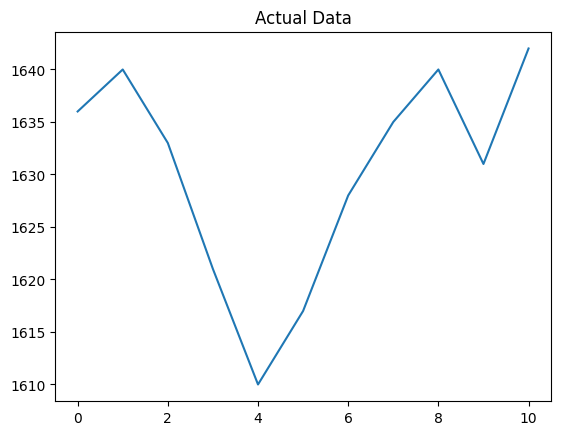

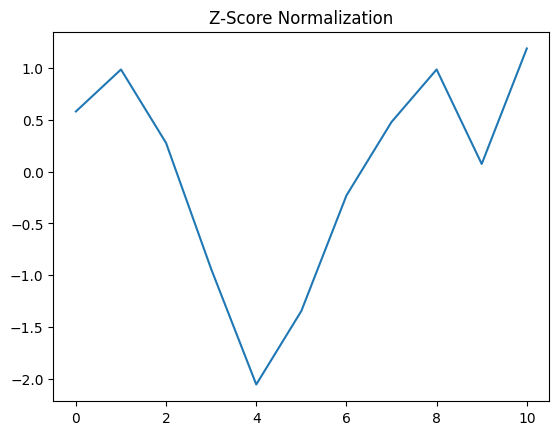

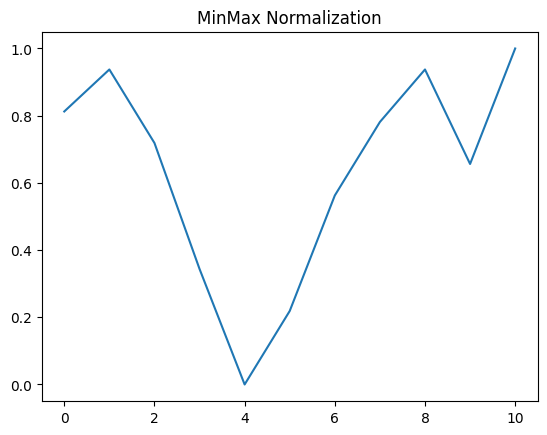

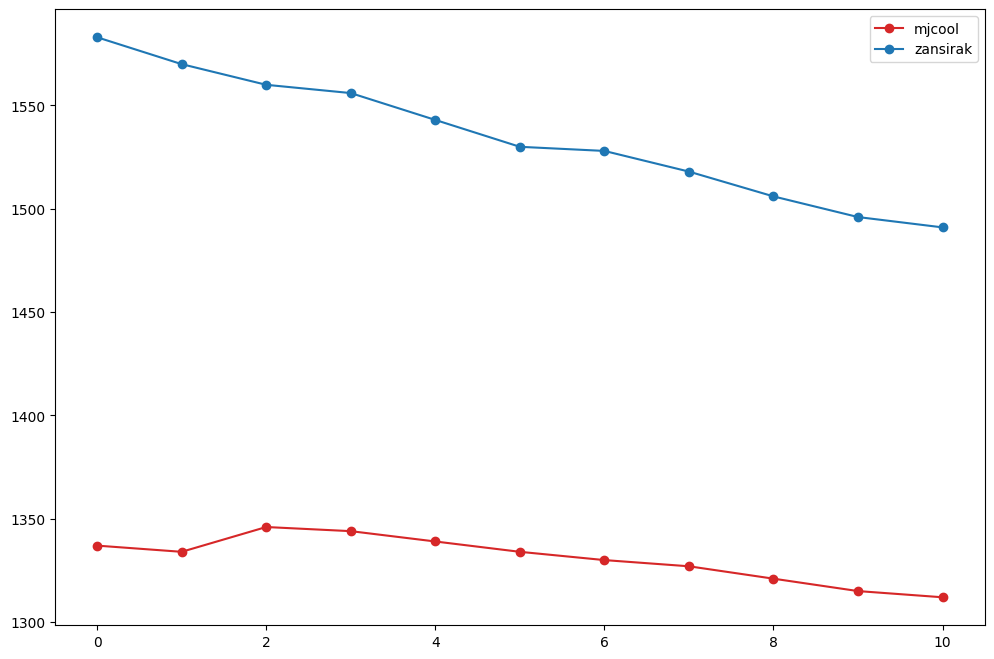

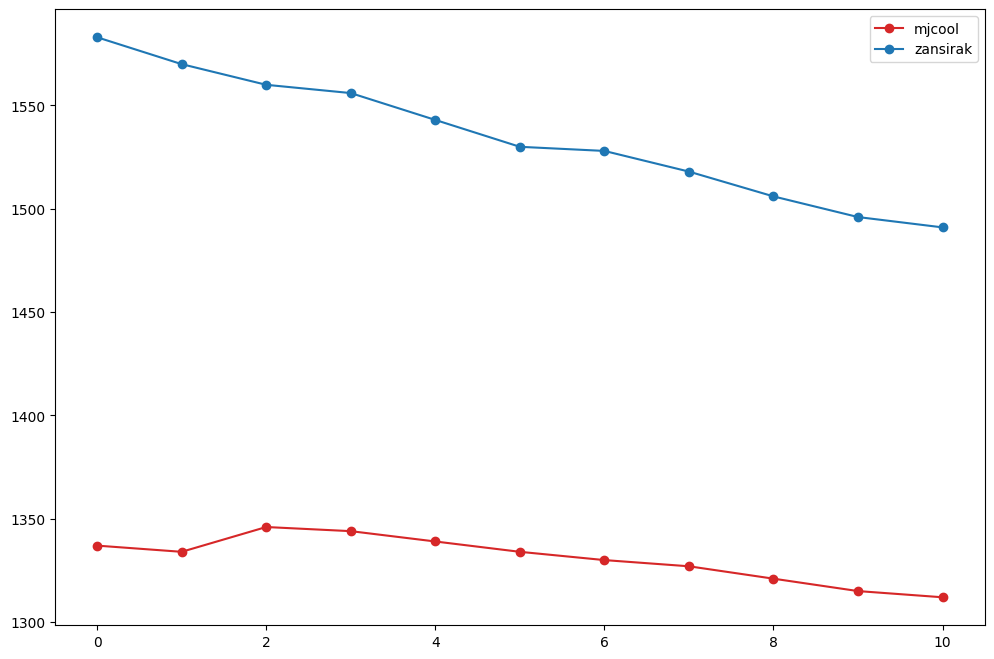

In [51]:
# Select a product Id to compare normal data with scaled data
product = "malick"

# Visualize the sales (qty) for the product
df.loc[product].plot(title="Actual Data"), plt.show()
df_ss.loc[product].plot(title="Z-Score Normalization"), plt.show()
df_mm.loc[product].plot(title="MinMax Normalization"), plt.show();


x = df.loc["mjcool"]
y = df.loc["zansirak"]

plt.figure(figsize=(12, 8))
plt.plot(x, "-o", c="C3")
plt.plot(y, "-o", c="C0")
plt.legend([x.name, y.name]);

# Select moving average sales
w = df.loc["mjcool"]
z = df.loc["zansirak"]

plt.figure(figsize=(12, 8))
plt.plot(w, "-o", c="C3")
plt.plot(z, "-o", c="C0")
plt.legend([w.name, z.name]);

Alignment cost: 2242.0000
Normalized alignment cost: 101.9091


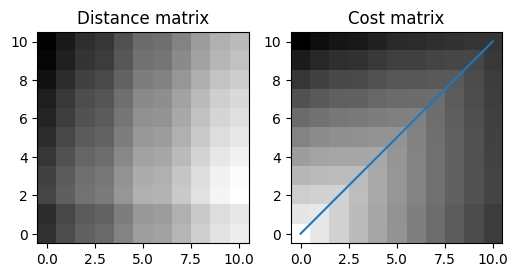

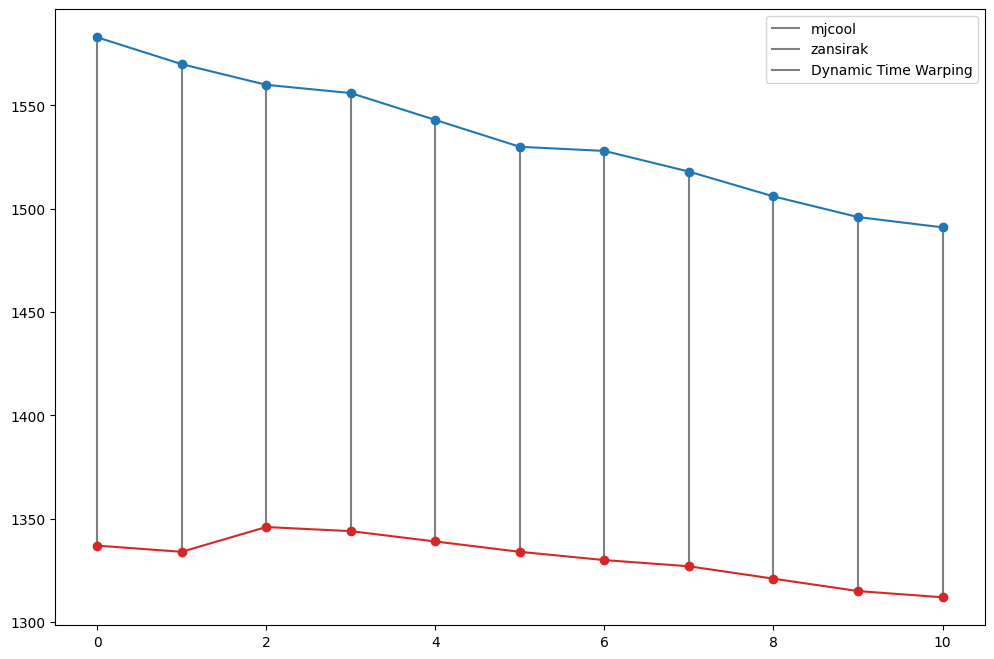

In [52]:
# Distance matrix
N = w.shape[0]
M = z.shape[0]
dist_mat = np.zeros((N, M))
for i in range(N):
    for j in range(M):
        dist_mat[i, j] = abs(x[i] - y[j])


# DTW
path, cost_mat = dp(dist_mat)
print("Alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]))
print("Normalized alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]/(N + M)))

plt.figure(figsize=(6, 4))
plt.subplot(121)
plt.title("Distance matrix")
plt.imshow(dist_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
plt.subplot(122)
plt.title("Cost matrix")
plt.imshow(cost_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
x_path, y_path = zip(*path)
plt.plot(y_path, x_path);

plt.figure(figsize=(12, 8))
for x_i, y_j in path:
    plt.plot([x_i, y_j], [w[x_i], z[y_j]], c="C7")
plt.plot(np.arange(w.shape[0]), w, "-o", c="C3")
plt.plot(np.arange(z.shape[0]), z, "-o", c="C0")
plt.legend([w.name, z.name, "Dynamic Time Warping"]);

#### dtw & normalized & wcsss

In [ ]:
# dtw
wcss=kmeans_wcsss(X_train,"dtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
labels=kmeans_cluster(10,"kmeans_dtw_v2_10",X_train,"dtw")
df["kmeans_dtw"]=labels

#### softdtw & normalized  & wcsss

In [ ]:
# softdtw
wcss=kmeans_wcsss(X_train,"softdtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(4,"kmeans_softdtw_10",X_train,"softdtw")

#### euclidean & normalized  & wcsss

K = 2. Took 1.85 seconds to calculate.
K = 3. Took 4.62 seconds to calculate.
K = 4. Took 7.13 seconds to calculate.
K = 5. Took 4.28 seconds to calculate.
K = 6. Took 6.02 seconds to calculate.
K = 7. Took 7.59 seconds to calculate.
K = 8. Took 7.64 seconds to calculate.
K = 9. Took 5.75 seconds to calculate.


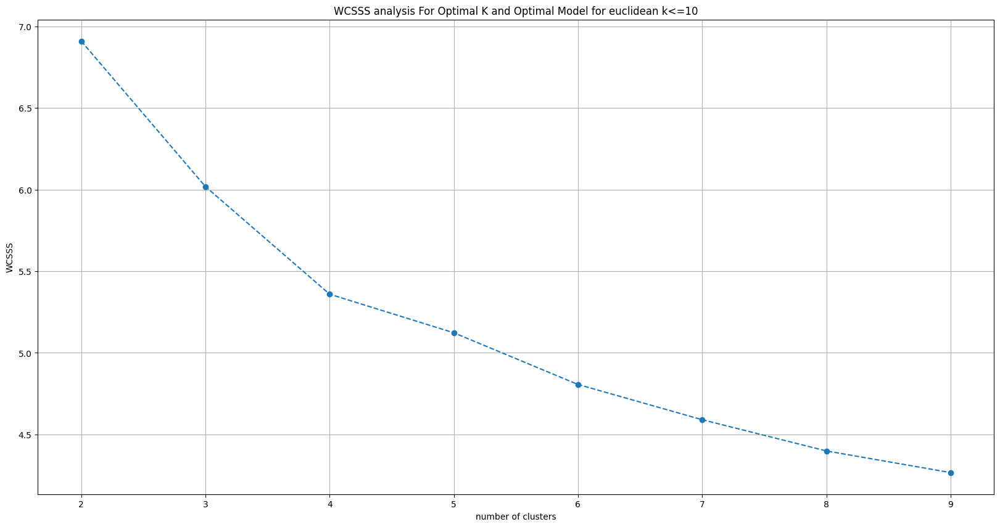

In [56]:
kmeans_wcss_plot(X_train,"euclidean",10)

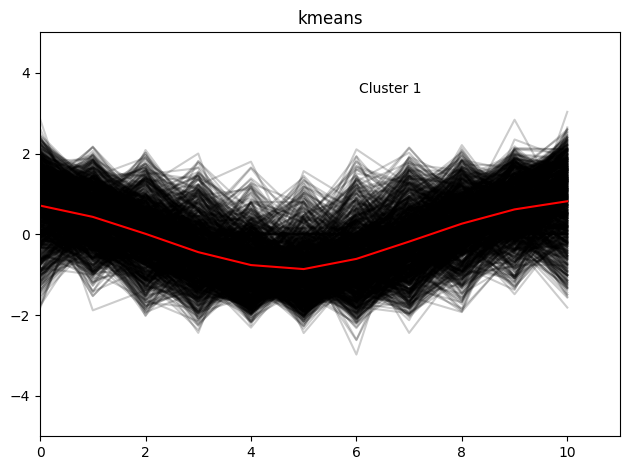

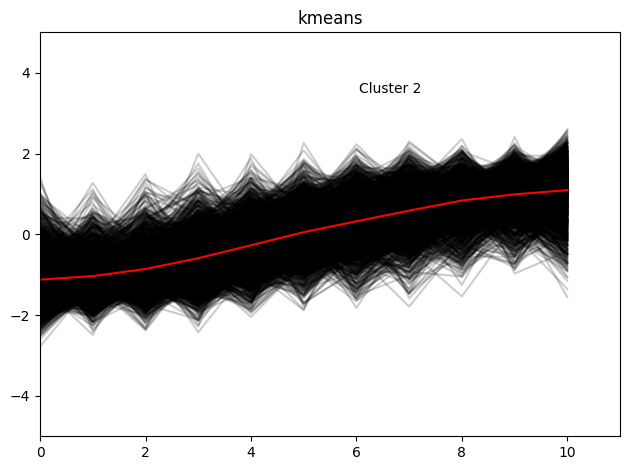

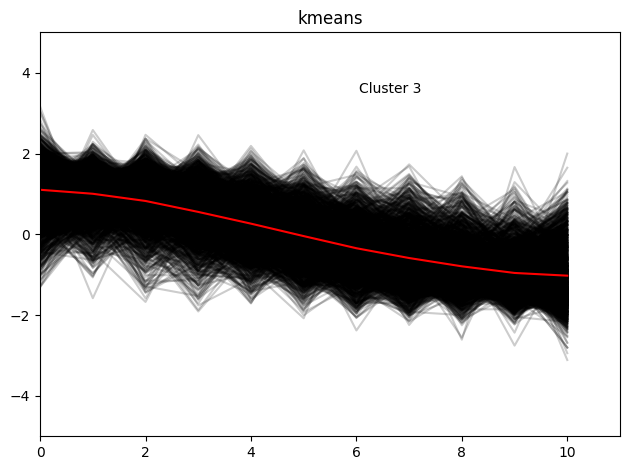

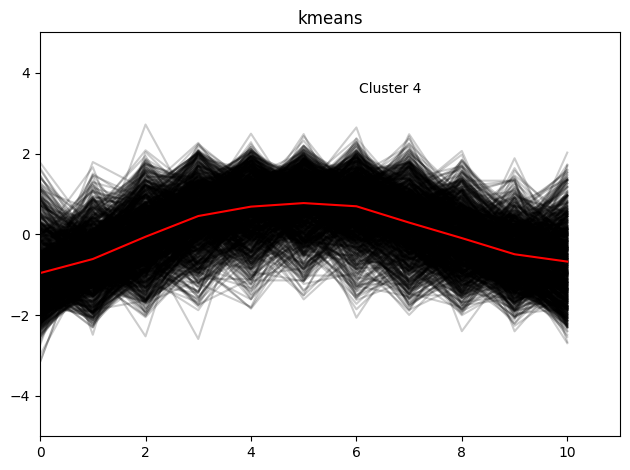

The 16.75% of the observations fall into Cluster 1
The 32.80% of the observations fall into Cluster 2
The 33.31% of the observations fall into Cluster 3
The 17.15% of the observations fall into Cluster 4


In [61]:
labels=kmeans_cluster(4,"kmeans_euclidean_v2_10",X_train,"euclidean")

In [76]:
players_dict

{'SujithLenin':           Player   Elo        Date      Time  Year  Month  Day     Timestamp
 0    SujithLenin  1720  2019.08.16  05:25:00  2019      8   16  1.565933e+09
 1    SujithLenin  1699  2019.08.18  01:50:00  2019      8   18  1.566093e+09
 2    SujithLenin  1682  2019.08.18  02:27:00  2019      8   18  1.566095e+09
 3    SujithLenin  1667  2019.08.20  05:37:00  2019      8   20  1.566279e+09
 4    SujithLenin  1530  2019.08.21  06:31:00  2019      8   21  1.566369e+09
 ..           ...   ...         ...       ...   ...    ...  ...           ...
 347  SujithLenin  1543  2021.07.14  03:25:00  2021      7   14  1.626233e+09
 348  SujithLenin  1526  2021.08.08  00:41:00  2021      8    8  1.628383e+09
 349  SujithLenin  1446  2021.08.28  23:02:00  2021      8   28  1.630192e+09
 350  SujithLenin  1391  2022.04.28  14:08:00  2022      4   28  1.651155e+09
 351  SujithLenin  1387  2023.01.05  07:40:00  2023      1    5  1.672904e+09
 
 [352 rows x 8 columns],
 'gavmo':     Player  

In [98]:
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open("data/lichess/dataset_raw/player_series_labels_v2_10_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

#### other scoring

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"dtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('silhoutte');
plt.title("Silhouette analysis For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"softdtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('silhoutte');
plt.title("Silhouette analysis For Optimal K and Optimal Model")

In [ ]:
wcss=kmeans_wcsss(X,"euclidean")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"dtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"softdtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"euclidean")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

## length 25 timeseries

In [102]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,25)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,25)).T

{'SujithLenin': 50    1.571210e+09
51    1.571270e+09
52    1.571270e+09
53    1.571279e+09
54    1.571354e+09
55    1.571370e+09
56    1.571449e+09
57    1.571466e+09
58    1.571529e+09
59    1.571800e+09
60    1.571802e+09
61    1.571802e+09
62    1.571808e+09
63    1.571884e+09
64    1.572056e+09
65    1.572423e+09
66    1.572595e+09
67    1.572596e+09
68    1.572664e+09
69    1.572673e+09
70    1.572684e+09
71    1.572685e+09
72    1.572745e+09
73    1.572942e+09
74    1.572945e+09
Name: Timestamp, dtype: float64, 'gavmo': 50    1.423297e+09
51    1.423299e+09
52    1.423300e+09
53    1.423341e+09
54    1.423357e+09
55    1.423358e+09
56    1.423359e+09
57    1.423360e+09
58    1.423369e+09
59    1.423370e+09
60    1.423371e+09
61    1.423444e+09
62    1.423445e+09
63    1.423451e+09
64    1.423452e+09
65    1.423454e+09
66    1.423461e+09
67    1.423519e+09
68    1.423527e+09
69    1.423530e+09
70    1.423537e+09
71    1.423541e+09
72    1.423557e+09
73    1.423559e+09
74    1.423

,50,51,52,53,54,55,56,57,58,59,...,65,66,67,68,69,70,71,72,73,74
SujithLenin,1.571210e+09,1.571270e+09,1.571270e+09,1.571279e+09,1.571354e+09,1.571370e+09,1.571449e+09,1.571466e+09,1.571529e+09,1.571800e+09,...,1.572423e+09,1.572595e+09,1.572596e+09,1.572664e+09,1.572673e+09,1.572684e+09,1.572685e+09,1.572745e+09,1.572942e+09,1.572945e+09
gavmo,1.423297e+09,1.423299e+09,1.423300e+09,1.423341e+09,1.423357e+09,1.423358e+09,1.423359e+09,1.423360e+09,1.423369e+09,1.423370e+09,...,1.423454e+09,1.423461e+09,1.423519e+09,1.423527e+09,1.423530e+09,1.423537e+09,1.423541e+09,1.423557e+09,1.423559e+09,1.423621e+09
AzianPowah,1.430158e+09,1.430159e+09,1.430160e+09,1.430160e+09,1.430208e+09,1.430209e+09,1.430209e+09,1.430210e+09,1.430211e+09,1.430216e+09,...,1.430293e+09,1.430293e+09,1.430294e+09,1.430294e+09,1.430295e+09,1.430296e+09,1.430297e+09,1.430298e+09,1.430298e+09,1.430299e+09
Terramoto,1.421417e+09,1.421419e+09,1.421420e+09,1.421421e+09,1.421422e+09,1.421687e+09,1.421688e+09,1.421767e+09,1.421769e+09,1.421836e+09,...,1.421841e+09,1.421937e+09,1.421937e+09,1.422000e+09,1.422001e+09,1.422002e+09,1.422031e+09,1.422087e+09,1.422088e+09,1.422106e+09
paravion,1.459005e+09,1.459006e+09,1.459007e+09,1.459008e+09,1.459023e+09,1.459104e+09,1.459106e+09,1.459107e+09,1.459108e+09,1.459182e+09,...,1.459270e+09,1.459272e+09,1.459274e+09,1.459283e+09,1.459284e+09,1.459369e+09,1.459370e+09,1.459372e+09,1.464364e+09,1.472145e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
threeleggedrat,1.430243e+09,1.430656e+09,1.430853e+09,1.431027e+09,1.431098e+09,1.431552e+09,1.431699e+09,1.431716e+09,1.431717e+09,1.432415e+09,...,1.432752e+09,1.432764e+09,1.433628e+09,1.433628e+09,1.433710e+09,1.433770e+09,1.433771e+09,1.433773e+09,1.433773e+09,1.434063e+09
Jubela,1.420995e+09,1.420996e+09,1.420997e+09,1.421080e+09,1.421081e+09,1.421082e+09,1.421082e+09,1.421084e+09,1.421160e+09,1.421160e+09,...,1.421165e+09,1.421252e+09,1.421253e+09,1.421253e+09,1.421254e+09,1.421254e+09,1.421255e+09,1.421512e+09,1.421512e+09,1.421513e+09
pankajydv,1.444520e+09,1.444521e+09,1.445001e+09,1.445588e+09,1.445593e+09,1.445594e+09,1.445597e+09,1.447571e+09,1.447836e+09,1.451029e+09,...,1.451082e+09,1.451123e+09,1.451189e+09,1.451191e+09,1.451199e+09,1.451199e+09,1.451217e+09,1.451290e+09,1.451294e+09,1.451294e+09
Gelenjonson,1.554012e+09,1.554013e+09,1.554050e+09,1.554114e+09,1.554140e+09,1.554206e+09,1.554313e+09,1.554313e+09,1.554354e+09,1.554401e+09,...,1.554715e+09,1.554717e+09,1.554802e+09,1.554879e+09,1.554888e+09,1.554895e+09,1.555148e+09,1.555152e+09,1.555154e+09,1.555154e+09


In [103]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
SujithLenin,0.415073,1.602781,1.477759,1.040182,0.977671,1.602781,1.477759,0.415073,0.352562,0.102518,...,0.290051,-0.147526,-0.960168,-1.460256,-0.647613,-1.772810,-1.460256,-0.835146,-0.960168,-1.085190
gavmo,-1.267402,-1.748520,-1.129940,-0.511360,0.107221,0.657070,1.138188,1.619306,2.100424,1.619306,...,-0.717553,0.038489,-0.305166,0.244683,-0.236435,-0.717553,-0.030242,-0.511360,-1.061209,-1.542327
AzianPowah,0.802891,0.802891,0.175632,-0.765255,-0.294811,1.116520,1.430149,1.743778,0.175632,-0.137997,...,-1.235699,0.489261,-0.451626,0.646076,1.273334,-0.137997,-0.608441,0.959705,-1.235699,0.018818
Terramoto,0.613911,-0.116936,-0.847782,-1.578629,-0.604167,-1.944053,-0.969590,0.004872,1.101143,0.857527,...,1.101143,-0.116936,0.126680,0.126680,-0.969590,-0.116936,-1.213206,-0.482359,0.248488,-0.847782
paravion,2.134765,1.429446,1.272709,0.802496,0.253915,0.802496,0.253915,-0.294667,-0.686510,0.018809,...,-0.294667,0.253915,-0.373035,0.332284,-0.216298,-0.216298,-0.764879,-1.313460,-1.940410,-2.724098


,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
SujithLenin,0.648148,1.000000,0.962963,0.833333,0.814815,1.000000,0.962963,0.648148,0.629630,0.555556,...,0.611111,0.481481,0.240741,0.092593,0.333333,0.000000,0.092593,0.277778,0.240741,0.203704
gavmo,0.125000,0.000000,0.160714,0.321429,0.482143,0.625000,0.750000,0.875000,1.000000,0.875000,...,0.267857,0.464286,0.375000,0.517857,0.392857,0.267857,0.446429,0.321429,0.178571,0.053571
AzianPowah,0.785714,0.785714,0.642857,0.428571,0.535714,0.857143,0.928571,1.000000,0.642857,0.571429,...,0.321429,0.714286,0.500000,0.750000,0.892857,0.571429,0.464286,0.821429,0.321429,0.607143
Terramoto,0.600000,0.428571,0.257143,0.085714,0.314286,0.000000,0.228571,0.457143,0.714286,0.657143,...,0.714286,0.428571,0.485714,0.485714,0.228571,0.428571,0.171429,0.342857,0.514286,0.257143
paravion,1.000000,0.854839,0.822581,0.725806,0.612903,0.725806,0.612903,0.500000,0.419355,0.564516,...,0.500000,0.612903,0.483871,0.629032,0.516129,0.516129,0.403226,0.290323,0.161290,0.000000


(5930, 25, 1) (5930, 25, 1)
CPU times: user 467 ms, sys: 0 ns, total: 467 ms
Wall time: 466 ms


In [104]:
# Select a product Id to compare normal data with scaled data
product = "dachampChi"

# Visualize the sales (qty) for the product
df.loc[product].plot(title="Actual Data"), plt.show()
df_ss.loc[product].plot(title="Z-Score Normalization"), plt.show()
df_mm.loc[product].plot(title="MinMax Normalization"), plt.show();


x = df.loc["petedoherty"]
y = df.loc["tom62"]

plt.figure(figsize=(12, 8))
plt.plot(x, "-o", c="C3")
plt.plot(y, "-o", c="C0")
plt.legend([x.name, y.name]);

# Select moving average sales
w = df.loc["petedoherty"]
z = df.loc["tom62"]

plt.figure(figsize=(12, 8))
plt.plot(w, "-o", c="C3")
plt.plot(z, "-o", c="C0")
plt.legend([w.name, z.name]);

KeyError: 'dachampChi'

Alignment cost: 2242.0000
Normalized alignment cost: 101.9091


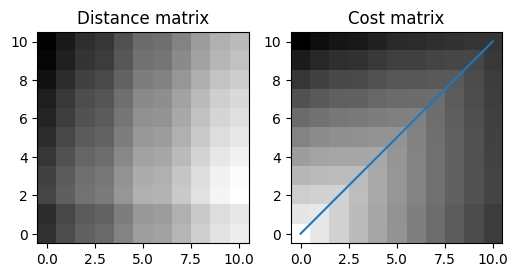

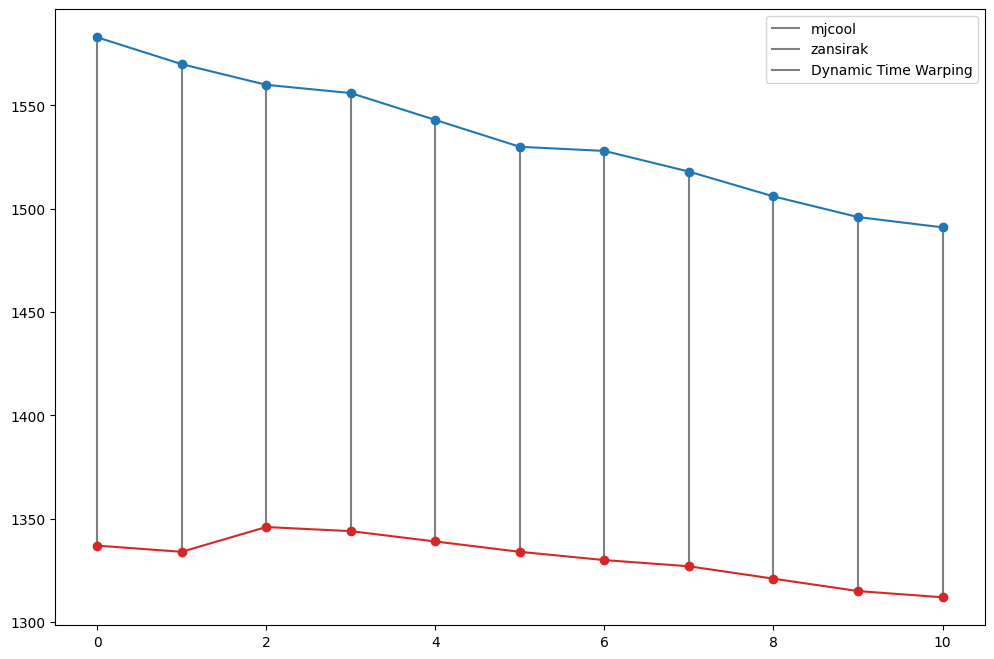

In [105]:
# Distance matrix
N = w.shape[0]
M = z.shape[0]
dist_mat = np.zeros((N, M))
for i in range(N):
    for j in range(M):
        dist_mat[i, j] = abs(x[i] - y[j])


# DTW
path, cost_mat = dp(dist_mat)
print("Alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]))
print("Normalized alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]/(N + M)))

plt.figure(figsize=(6, 4))
plt.subplot(121)
plt.title("Distance matrix")
plt.imshow(dist_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
plt.subplot(122)
plt.title("Cost matrix")
plt.imshow(cost_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
x_path, y_path = zip(*path)
plt.plot(y_path, x_path);

plt.figure(figsize=(12, 8))
for x_i, y_j in path:
    plt.plot([x_i, y_j], [w[x_i], z[y_j]], c="C7")
plt.plot(np.arange(w.shape[0]), w, "-o", c="C3")
plt.plot(np.arange(z.shape[0]), z, "-o", c="C0")
plt.legend([w.name, z.name, "Dynamic Time Warping"]);

#### dtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(13,"kmeans_dtw_25_v2",X_train,"dtw")

#### softdtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"softdtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(13,"kmeans_softdtw_25",X_train,"softdtw")

#### euclidean & normalized & wcsss

16.046729968152878
K = 2. Took 1.28 seconds to calculate.
14.201850315987983
K = 3. Took 2.00 seconds to calculate.
12.673491876066336
K = 4. Took 7.56 seconds to calculate.
11.971902699049085
K = 5. Took 3.07 seconds to calculate.
11.461547348670312
K = 6. Took 5.05 seconds to calculate.
10.998025444941998
K = 7. Took 7.62 seconds to calculate.
10.561941290566251
K = 8. Took 4.57 seconds to calculate.
10.284275110565257
K = 9. Took 5.56 seconds to calculate.


Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

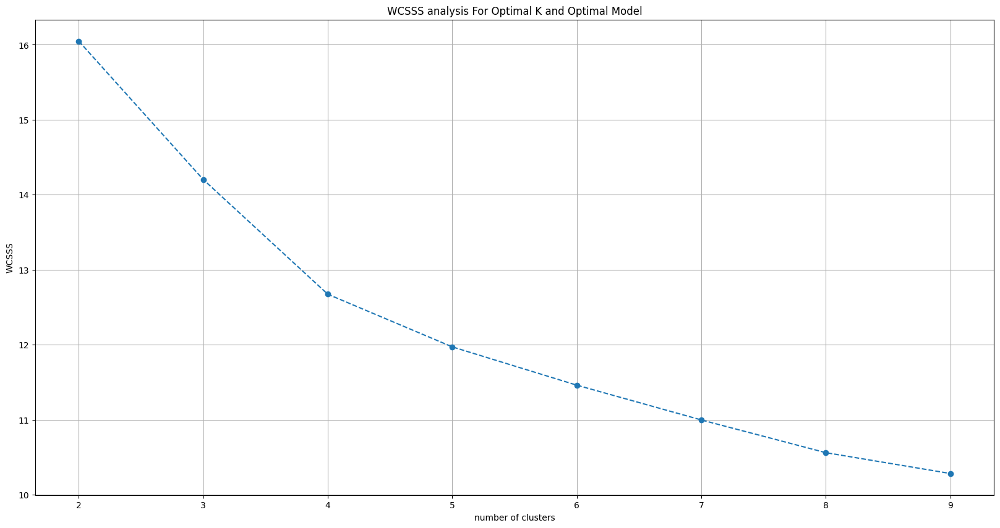

In [107]:
wcss=kmeans_wcsss(X_train,"euclidean",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

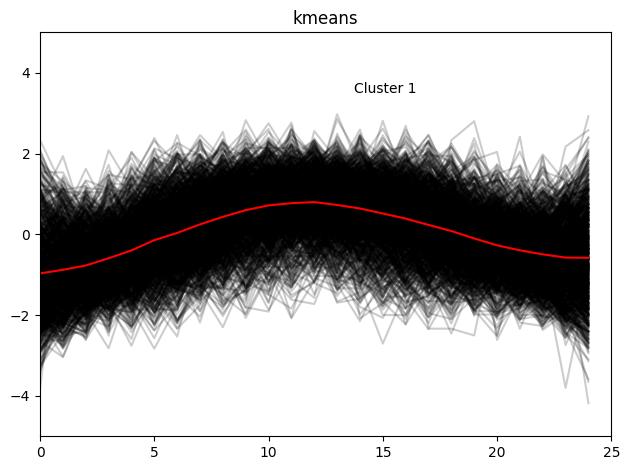

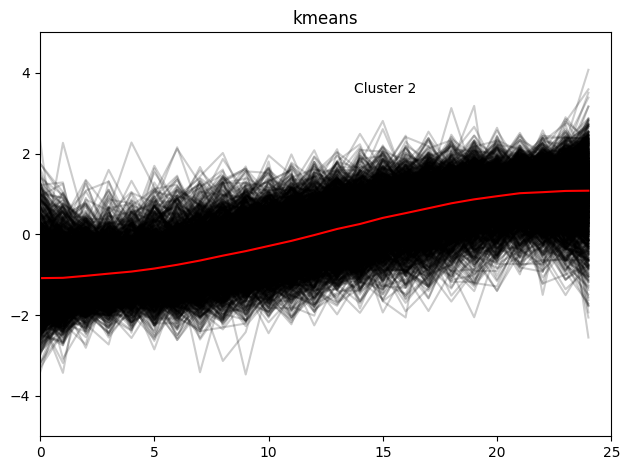

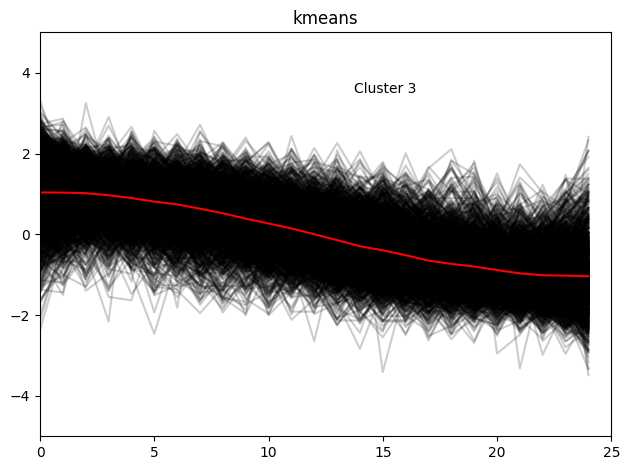

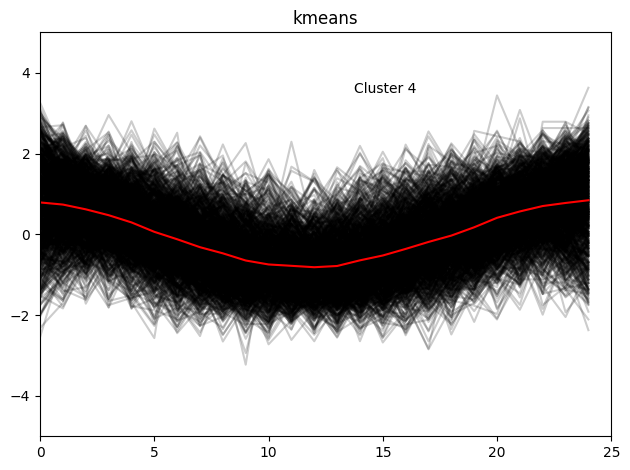

The 17.37% of the observations fall into Cluster 1
The 34.45% of the observations fall into Cluster 2
The 31.08% of the observations fall into Cluster 3
The 17.10% of the observations fall into Cluster 4


In [109]:
labels=kmeans_cluster(4,"kmeans_euclidean_v2_25",X_train,"euclidean")
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open("data/lichess/dataset_raw/player_series_labels_v2_25_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

#### other scoring

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"dtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('silhoutte');
plt.title("Silhouette analysis For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"softdtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('silhoutte');
plt.title("Silhouette analysis For Optimal K and Optimal Model")

In [ ]:
wcss=kmeans_wcsss(X,"euclidean")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"dtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"softdtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"euclidean")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

## length 50 timeseries

In [110]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,50)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,50)).T
display(df.head())

{'SujithLenin': 50    1.571210e+09
51    1.571270e+09
52    1.571270e+09
53    1.571279e+09
54    1.571354e+09
55    1.571370e+09
56    1.571449e+09
57    1.571466e+09
58    1.571529e+09
59    1.571800e+09
60    1.571802e+09
61    1.571802e+09
62    1.571808e+09
63    1.571884e+09
64    1.572056e+09
65    1.572423e+09
66    1.572595e+09
67    1.572596e+09
68    1.572664e+09
69    1.572673e+09
70    1.572684e+09
71    1.572685e+09
72    1.572745e+09
73    1.572942e+09
74    1.572945e+09
75    1.573246e+09
76    1.573271e+09
77    1.573276e+09
78    1.573333e+09
79    1.573333e+09
80    1.573462e+09
81    1.573474e+09
82    1.573475e+09
83    1.573475e+09
84    1.573606e+09
85    1.573607e+09
86    1.573618e+09
87    1.573625e+09
88    1.573640e+09
89    1.573684e+09
90    1.573717e+09
91    1.573773e+09
92    1.573774e+09
93    1.573774e+09
94    1.573795e+09
95    1.573795e+09
96    1.573846e+09
97    1.573847e+09
98    1.573870e+09
99    1.573872e+09
Name: Timestamp, dtype: float64, '

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
SujithLenin,1634,1653,1651,1644,1643,1653,1651,1634,1633,1629,...,1581,1573,1578,1576,1573,1569,1565,1558,1556,1554
gavmo,1406,1399,1408,1417,1426,1434,1441,1448,1455,1448,...,1423,1432,1442,1438,1434,1446,1456,1446,1457,1452
AzianPowah,1619,1619,1615,1609,1612,1621,1623,1625,1615,1613,...,1591,1600,1605,1615,1605,1595,1599,1604,1596,1605
Terramoto,1661,1655,1649,1643,1651,1640,1648,1656,1665,1663,...,1668,1675,1665,1671,1662,1665,1668,1674,1676,1667
paravion,1764,1755,1753,1747,1740,1747,1740,1733,1728,1737,...,1783,1810,1787,1766,1751,1738,1734,1740,1739,1756


In [111]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
SujithLenin,1.024807,1.747038,1.671014,1.404929,1.366917,1.747038,1.671014,1.024807,0.986795,0.834747,...,-0.989836,-1.293933,-1.103873,-1.179897,-1.293933,-1.445982,-1.598030,-1.864115,-1.940140,-2.016164
gavmo,-1.601687,-2.101322,-1.458934,-0.816546,-0.174159,0.396853,0.896488,1.396123,1.895758,1.396123,...,-0.388288,0.254100,0.967865,0.682359,0.396853,1.253370,1.967135,1.253370,2.038511,1.681629
AzianPowah,0.990587,0.990587,0.678591,0.210597,0.444594,1.146584,1.302582,1.458580,0.678591,0.522593,...,-1.193384,-0.491393,-0.101399,0.678591,-0.101399,-0.881388,-0.569392,-0.179398,-0.803389,-0.101399
Terramoto,-0.045256,-0.662383,-1.279510,-1.896638,-1.073801,-2.205201,-1.382365,-0.559529,0.366162,0.160453,...,0.674726,1.394707,0.366162,0.983289,0.057599,0.366162,0.674726,1.291853,1.497562,0.571871
paravion,0.424985,0.114020,0.044917,-0.162393,-0.404254,-0.162393,-0.404254,-0.646116,-0.818874,-0.507909,...,1.081466,2.014361,1.219673,0.494088,-0.024186,-0.473358,-0.611564,-0.404254,-0.438806,0.148572


,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
SujithLenin,0.808081,1.000000,0.979798,0.909091,0.898990,1.000000,0.979798,0.808081,0.797980,0.757576,...,0.272727,0.191919,0.242424,0.222222,0.191919,0.151515,0.111111,0.040404,0.020202,0.000000
gavmo,0.120690,0.000000,0.155172,0.310345,0.465517,0.603448,0.724138,0.844828,0.965517,0.844828,...,0.413793,0.568966,0.741379,0.672414,0.603448,0.810345,0.982759,0.810345,1.000000,0.913793
AzianPowah,0.880000,0.880000,0.800000,0.680000,0.740000,0.920000,0.960000,1.000000,0.800000,0.760000,...,0.320000,0.500000,0.600000,0.800000,0.600000,0.400000,0.480000,0.580000,0.420000,0.600000
Terramoto,0.488372,0.348837,0.209302,0.069767,0.255814,0.000000,0.186047,0.372093,0.581395,0.534884,...,0.651163,0.813953,0.581395,0.720930,0.511628,0.581395,0.651163,0.790698,0.837209,0.627907
paravion,0.466165,0.398496,0.383459,0.338346,0.285714,0.338346,0.285714,0.233083,0.195489,0.263158,...,0.609023,0.812030,0.639098,0.481203,0.368421,0.270677,0.240602,0.285714,0.278195,0.406015


(5930, 50, 1) (5930, 50, 1)
CPU times: user 458 ms, sys: 7.98 ms, total: 466 ms
Wall time: 465 ms


In [112]:


# Select a product Id to compare normal data with scaled data
product = "dachampChi"

# Visualize the sales (qty) for the product
df.loc[product].plot(title="Actual Data"), plt.show()
df_ss.loc[product].plot(title="Z-Score Normalization"), plt.show()
df_mm.loc[product].plot(title="MinMax Normalization"), plt.show();


x = df.loc["petedoherty"]
y = df.loc["tom62"]

plt.figure(figsize=(12, 8))
plt.plot(x, "-o", c="C3")
plt.plot(y, "-o", c="C0")
plt.legend([x.name, y.name]);

# Select moving average sales
w = df.loc["petedoherty"]
z = df.loc["tom62"]

plt.figure(figsize=(12, 8))
plt.plot(w, "-o", c="C3")
plt.plot(z, "-o", c="C0")
plt.legend([w.name, z.name]);



KeyError: 'dachampChi'

Alignment cost: 2242.0000
Normalized alignment cost: 101.9091


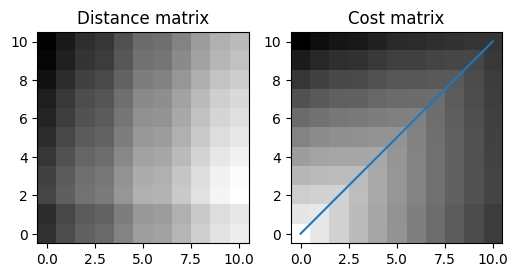

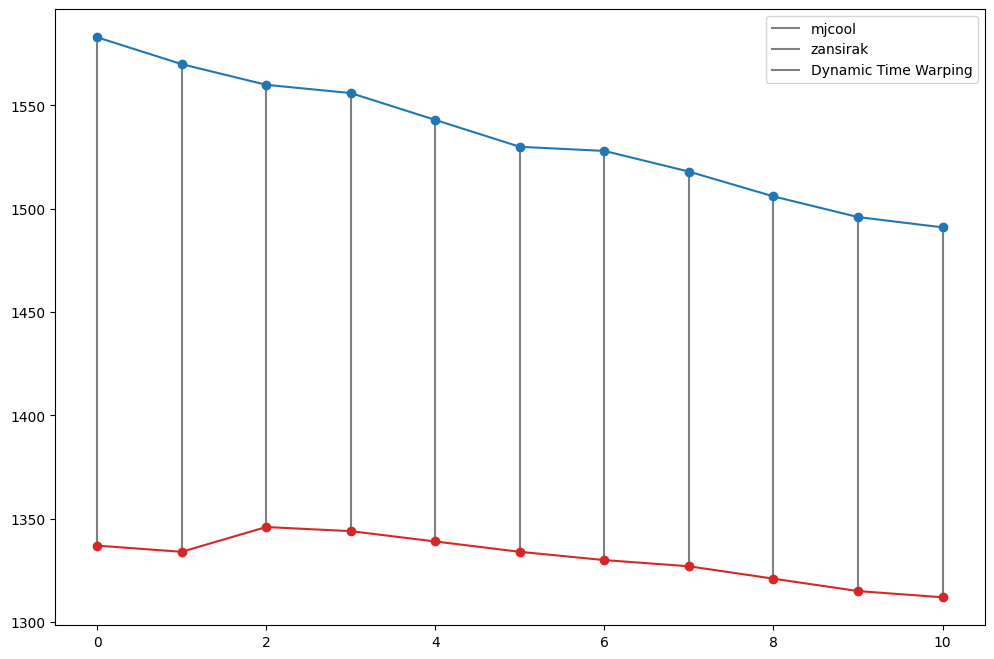

In [113]:

# Distance matrix
N = w.shape[0]
M = z.shape[0]
dist_mat = np.zeros((N, M))
for i in range(N):
    for j in range(M):
        dist_mat[i, j] = abs(x[i] - y[j])


# DTW
path, cost_mat = dp(dist_mat)
print("Alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]))
print("Normalized alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]/(N + M)))

plt.figure(figsize=(6, 4))
plt.subplot(121)
plt.title("Distance matrix")
plt.imshow(dist_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
plt.subplot(122)
plt.title("Cost matrix")
plt.imshow(cost_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
x_path, y_path = zip(*path)
plt.plot(y_path, x_path);

plt.figure(figsize=(12, 8))
for x_i, y_j in path:
    plt.plot([x_i, y_j], [w[x_i], z[y_j]], c="C7")
plt.plot(np.arange(w.shape[0]), w, "-o", c="C3")
plt.plot(np.arange(z.shape[0]), z, "-o", c="C0")
plt.legend([w.name, z.name, "Dynamic Time Warping"]);

#### dtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(9,"kmeans_dtw_50_v2",X_train,"dtw")

#### softdtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"softdtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(13,"kmeans_softdtw_50",X_train,"softdtw")

#### euclidean & normalized & wcsss

In [ ]:
len(X_train[0])

32.86147668422861
K = 2. Took 1.59 seconds to calculate.
29.145750737660336
K = 3. Took 2.62 seconds to calculate.
26.171532979099197
K = 4. Took 5.68 seconds to calculate.
24.663504283989482
K = 5. Took 5.35 seconds to calculate.
23.625435512341134
K = 6. Took 6.32 seconds to calculate.
22.809293003427825
K = 7. Took 7.28 seconds to calculate.
22.00952868452298
K = 8. Took 7.69 seconds to calculate.
21.416516993007154
K = 9. Took 7.79 seconds to calculate.


Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

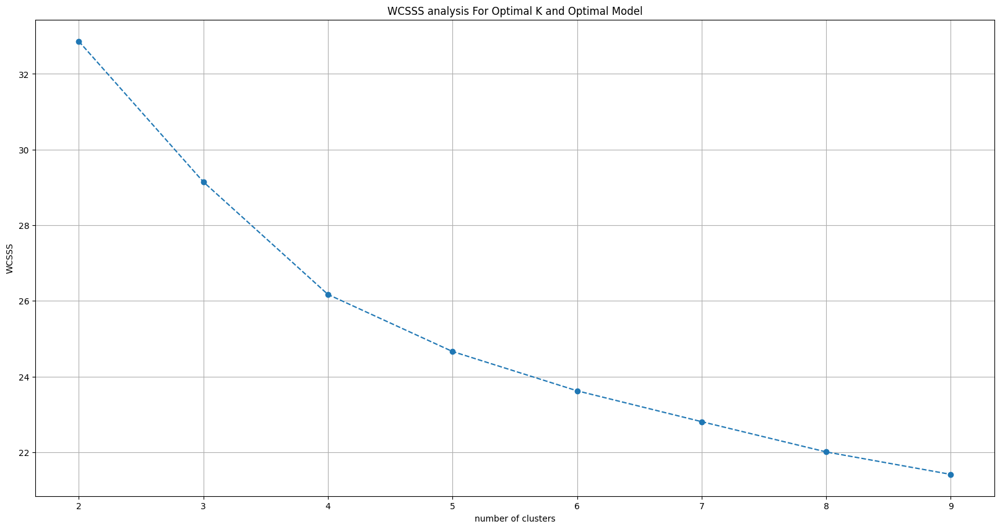

In [115]:
wcss=kmeans_wcsss(X_train,"euclidean",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

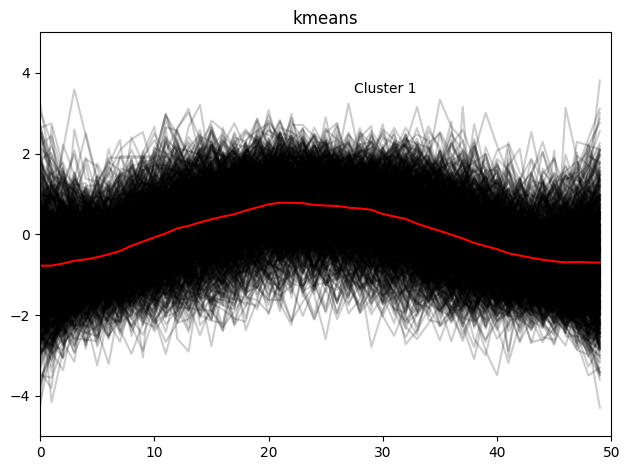

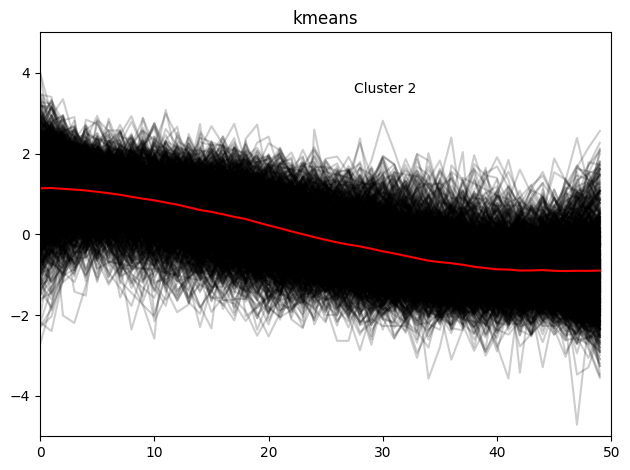

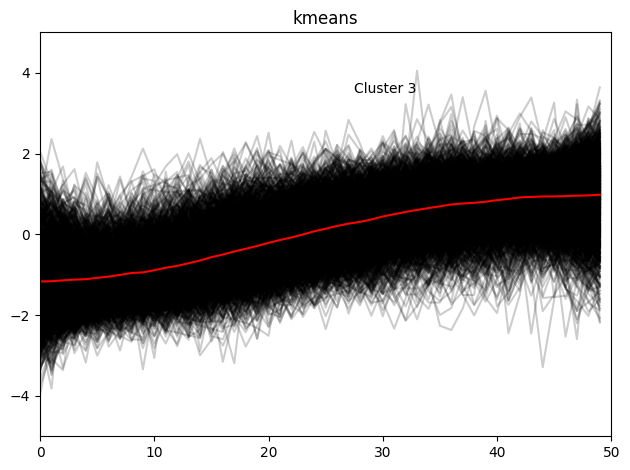

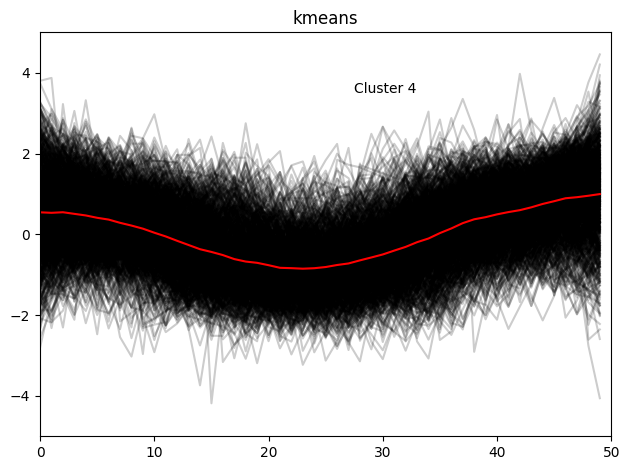

The 18.31% of the observations fall into Cluster 1
The 28.58% of the observations fall into Cluster 2
The 35.78% of the observations fall into Cluster 3
The 17.32% of the observations fall into Cluster 4


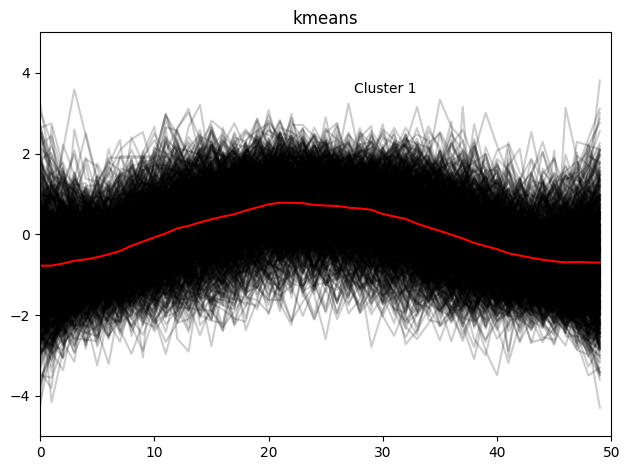

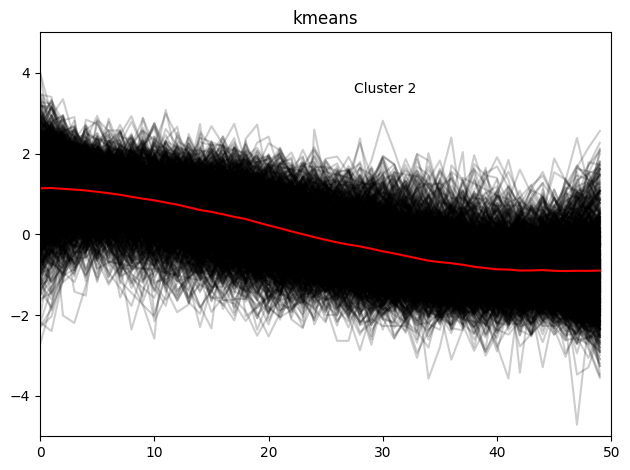

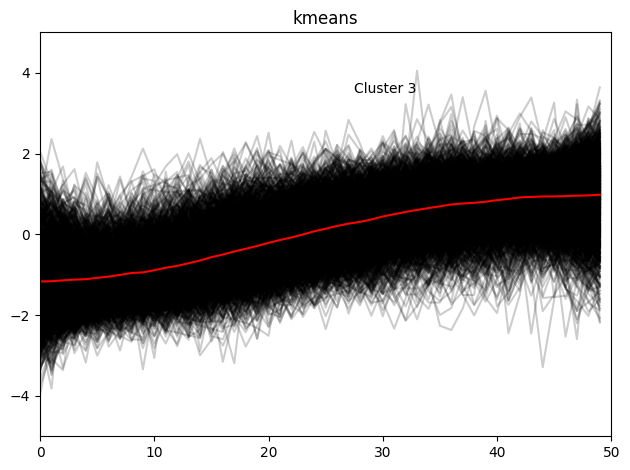

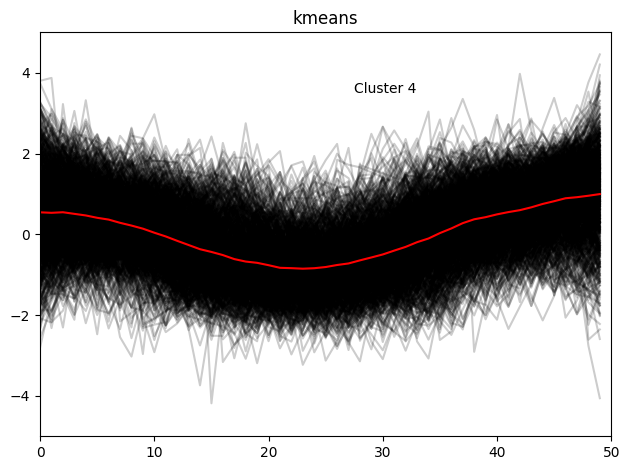

The 18.31% of the observations fall into Cluster 1
The 28.58% of the observations fall into Cluster 2
The 35.78% of the observations fall into Cluster 3
The 17.32% of the observations fall into Cluster 4


In [116]:
kmeans_cluster(4,"kmeans_euclidean_v2_50",X_train,"euclidean")
labels=kmeans_cluster(4,"kmeans_euclidean_v2_50",X_train,"euclidean")
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open("data/lichess/dataset_raw/player_series_labels_v2_50_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)



#### other scoring

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"dtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('silhoutte');
plt.title("Silhouette analysis For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"softdtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('silhoutte');
plt.title("Silhouette analysis For Optimal K and Optimal Model")

In [ ]:
wcss=kmeans_wcsss(X,"euclidean")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"dtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"softdtw")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"euclidean")
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),silhoutte,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('calinski harabasz');
plt.title("calinski harabasz For Optimal K and Optimal Model")

## Analyze cluster

In [ ]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,1)).T
largest_len=len(df)

curr_l=1
while True:
    df=pd.DataFrame.from_dict(get_samples(players_dict,50,curr_l)).T
    if len(df)<largest_len:
        break
    curr_l=curr_l+1



In [ ]:
print("Largest length is:",curr_l)

In [117]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,150)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,150)).T


{'SujithLenin': 50     1.571210e+09
51     1.571270e+09
52     1.571270e+09
53     1.571279e+09
54     1.571354e+09
           ...     
195    1.576284e+09
196    1.576312e+09
197    1.576324e+09
198    1.576481e+09
199    1.576483e+09
Name: Timestamp, Length: 150, dtype: float64, 'gavmo': 50     1.423297e+09
51     1.423299e+09
52     1.423300e+09
53     1.423341e+09
54     1.423357e+09
           ...     
195    1.429765e+09
196    1.429768e+09
197    1.429769e+09
198    1.430117e+09
199    1.430123e+09
Name: Timestamp, Length: 150, dtype: float64, 'AzianPowah': 50     1.430158e+09
51     1.430159e+09
52     1.430160e+09
53     1.430160e+09
54     1.430208e+09
           ...     
195    1.432036e+09
196    1.432114e+09
197    1.432203e+09
198    1.432208e+09
199    1.432209e+09
Name: Timestamp, Length: 150, dtype: float64, 'Terramoto': 50     1.421417e+09
51     1.421419e+09
52     1.421420e+09
53     1.421421e+09
54     1.421422e+09
           ...     
195    1.428142e+09
196    1.4

In [ ]:
df

In [118]:

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,1.858439,2.288948,2.243632,2.085023,2.062365,2.288948,2.243632,1.858439,1.835781,1.745147,...,-0.226131,-0.430056,-0.226131,-0.248789,-0.384739,-0.112839,-0.158155,-0.271447,-0.384739,-0.407397
gavmo,-1.101522,-1.467650,-0.996914,-0.526178,-0.055442,0.362990,0.729117,1.095245,1.461373,1.095245,...,1.199853,1.670589,1.984413,1.461373,1.827501,1.304461,1.775197,1.356765,0.990637,1.356765
AzianPowah,1.084705,1.084705,0.928106,0.693209,0.810658,1.163004,1.241303,1.319602,0.928106,0.849807,...,0.262563,0.536610,-0.050633,-0.481279,-0.207232,0.145115,0.301713,0.458311,0.693209,1.045555
Terramoto,0.886718,0.711400,0.536083,0.360765,0.594522,0.273106,0.506863,0.740620,1.003597,0.945157,...,-1.100216,-0.837240,-0.603483,-0.428165,-0.720361,-0.954118,-0.924898,-0.808020,-0.691141,-0.515824
paravion,0.486397,0.167796,0.096996,-0.115404,-0.363205,-0.115404,-0.363205,-0.611005,-0.788006,-0.469405,...,-0.504805,-0.611005,-0.788006,-0.894206,-1.000406,-1.283607,-1.566808,-1.814608,-1.991609,-2.168609


,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,0.883436,1.000000,0.987730,0.944785,0.938650,1.000000,0.987730,0.883436,0.877301,0.852761,...,0.319018,0.263804,0.319018,0.312883,0.276074,0.349693,0.337423,0.306748,0.276074,0.269939
gavmo,0.268817,0.193548,0.290323,0.387097,0.483871,0.569892,0.645161,0.720430,0.795699,0.720430,...,0.741935,0.838710,0.903226,0.795699,0.870968,0.763441,0.860215,0.774194,0.698925,0.774194
AzianPowah,0.768421,0.768421,0.726316,0.663158,0.694737,0.789474,0.810526,0.831579,0.726316,0.705263,...,0.547368,0.621053,0.463158,0.347368,0.421053,0.515789,0.557895,0.600000,0.663158,0.757895
Terramoto,0.833333,0.787879,0.742424,0.696970,0.757576,0.674242,0.734848,0.795455,0.863636,0.848485,...,0.318182,0.386364,0.446970,0.492424,0.416667,0.356061,0.363636,0.393939,0.424242,0.469697
paravion,0.513699,0.452055,0.438356,0.397260,0.349315,0.397260,0.349315,0.301370,0.267123,0.328767,...,0.321918,0.301370,0.267123,0.246575,0.226027,0.171233,0.116438,0.068493,0.034247,0.000000


(5930, 150, 1) (5930, 150, 1)


In [ ]:
wcss=kmeans_wcsss(X_train,"dtw",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(4,"kmeans_dtw_v2_150",X_train,"dtw")

In [ ]:
wcss=kmeans_wcsss(X_train,"softdtw",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

106.22798916496973
K = 2. Took 2.59 seconds to calculate.
95.06625661636933
K = 3. Took 1.96 seconds to calculate.
87.3863432089098
K = 4. Took 7.53 seconds to calculate.
82.94882831482502
K = 5. Took 6.88 seconds to calculate.
79.40384004795395
K = 6. Took 7.60 seconds to calculate.
76.62093193691923
K = 7. Took 7.94 seconds to calculate.
74.23437889805496
K = 8. Took 4.43 seconds to calculate.
72.47250434614118
K = 9. Took 7.44 seconds to calculate.


Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

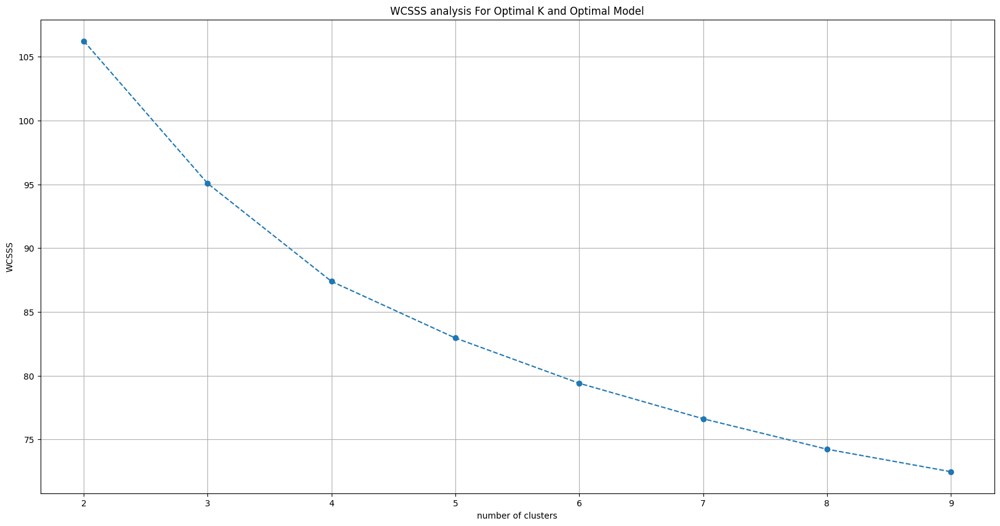

In [119]:
wcss=kmeans_wcsss(X_train,"euclidean",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

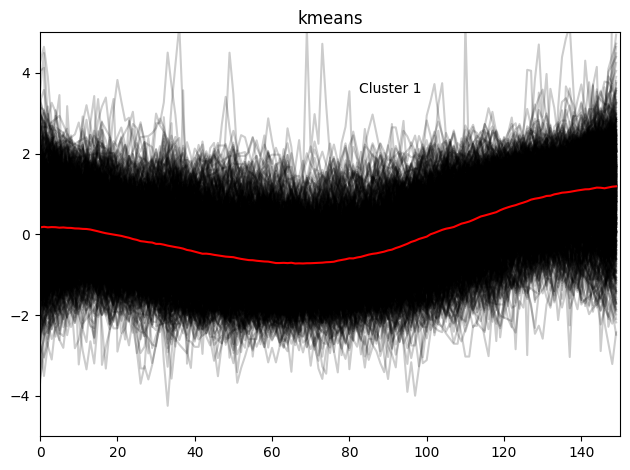

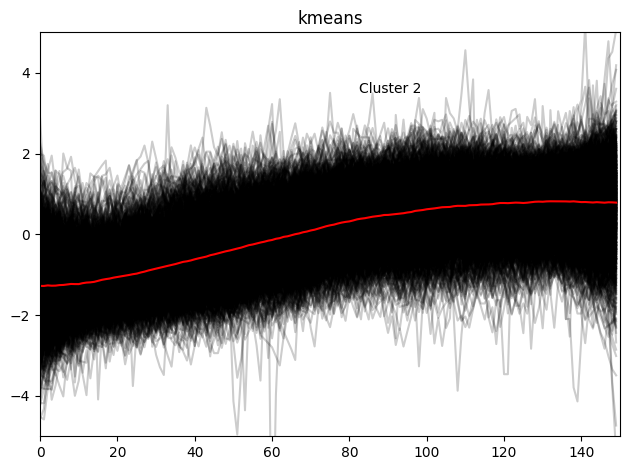

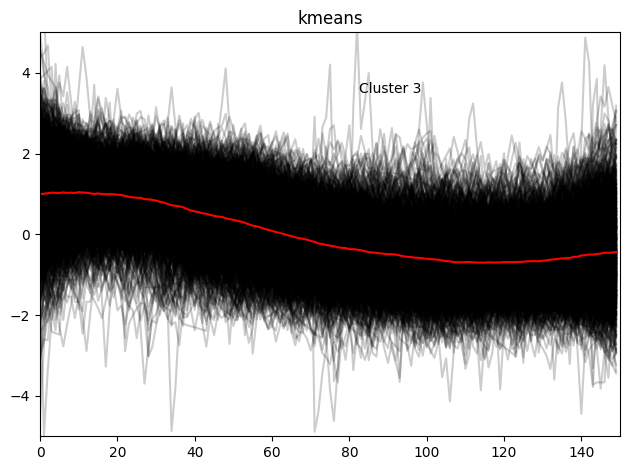

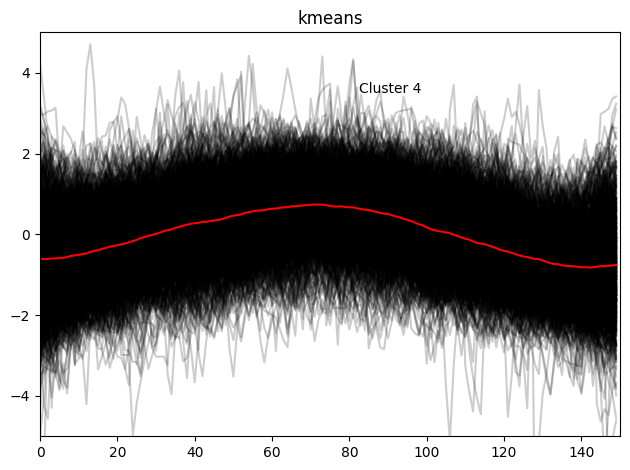

The 20.67% of the observations fall into Cluster 1
The 34.40% of the observations fall into Cluster 2
The 25.06% of the observations fall into Cluster 3
The 19.87% of the observations fall into Cluster 4


In [120]:
labels=kmeans_cluster(4,"kmeans_euclidean_v2_150",X_train,"euclidean")
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open("data/lichess/dataset_raw/player_series_labels_v2_150_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw",16)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,16),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(9,"kmeans_dtw_150_v2",X_train,"dtw")

{'SujithLenin': 50     1.571210e+09
51     1.571270e+09
52     1.571270e+09
53     1.571279e+09
54     1.571354e+09
           ...     
195    1.576284e+09
196    1.576312e+09
197    1.576324e+09
198    1.576481e+09
199    1.576483e+09
Name: Timestamp, Length: 150, dtype: float64, 'gavmo': 50     1.423297e+09
51     1.423299e+09
52     1.423300e+09
53     1.423341e+09
54     1.423357e+09
           ...     
195    1.429765e+09
196    1.429768e+09
197    1.429769e+09
198    1.430117e+09
199    1.430123e+09
Name: Timestamp, Length: 150, dtype: float64, 'AzianPowah': 50     1.430158e+09
51     1.430159e+09
52     1.430160e+09
53     1.430160e+09
54     1.430208e+09
           ...     
195    1.432036e+09
196    1.432114e+09
197    1.432203e+09
198    1.432208e+09
199    1.432209e+09
Name: Timestamp, Length: 150, dtype: float64, 'Terramoto': 50     1.421417e+09
51     1.421419e+09
52     1.421420e+09
53     1.421421e+09
54     1.421422e+09
           ...     
195    1.428142e+09
196    1.4

,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,1.858439,2.288948,2.243632,2.085023,2.062365,2.288948,2.243632,1.858439,1.835781,1.745147,...,-0.226131,-0.430056,-0.226131,-0.248789,-0.384739,-0.112839,-0.158155,-0.271447,-0.384739,-0.407397
gavmo,-1.101522,-1.467650,-0.996914,-0.526178,-0.055442,0.362990,0.729117,1.095245,1.461373,1.095245,...,1.199853,1.670589,1.984413,1.461373,1.827501,1.304461,1.775197,1.356765,0.990637,1.356765
AzianPowah,1.084705,1.084705,0.928106,0.693209,0.810658,1.163004,1.241303,1.319602,0.928106,0.849807,...,0.262563,0.536610,-0.050633,-0.481279,-0.207232,0.145115,0.301713,0.458311,0.693209,1.045555
Terramoto,0.886718,0.711400,0.536083,0.360765,0.594522,0.273106,0.506863,0.740620,1.003597,0.945157,...,-1.100216,-0.837240,-0.603483,-0.428165,-0.720361,-0.954118,-0.924898,-0.808020,-0.691141,-0.515824
paravion,0.486397,0.167796,0.096996,-0.115404,-0.363205,-0.115404,-0.363205,-0.611005,-0.788006,-0.469405,...,-0.504805,-0.611005,-0.788006,-0.894206,-1.000406,-1.283607,-1.566808,-1.814608,-1.991609,-2.168609


,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,0.883436,1.000000,0.987730,0.944785,0.938650,1.000000,0.987730,0.883436,0.877301,0.852761,...,0.319018,0.263804,0.319018,0.312883,0.276074,0.349693,0.337423,0.306748,0.276074,0.269939
gavmo,0.268817,0.193548,0.290323,0.387097,0.483871,0.569892,0.645161,0.720430,0.795699,0.720430,...,0.741935,0.838710,0.903226,0.795699,0.870968,0.763441,0.860215,0.774194,0.698925,0.774194
AzianPowah,0.768421,0.768421,0.726316,0.663158,0.694737,0.789474,0.810526,0.831579,0.726316,0.705263,...,0.547368,0.621053,0.463158,0.347368,0.421053,0.515789,0.557895,0.600000,0.663158,0.757895
Terramoto,0.833333,0.787879,0.742424,0.696970,0.757576,0.674242,0.734848,0.795455,0.863636,0.848485,...,0.318182,0.386364,0.446970,0.492424,0.416667,0.356061,0.363636,0.393939,0.424242,0.469697
paravion,0.513699,0.452055,0.438356,0.397260,0.349315,0.397260,0.349315,0.301370,0.267123,0.328767,...,0.321918,0.301370,0.267123,0.246575,0.226027,0.171233,0.116438,0.068493,0.034247,0.000000


(5930, 150, 1) (5930, 150, 1)
106.22798916496973
K = 2. Took 2.68 seconds to calculate.
95.06625661636933
K = 3. Took 1.88 seconds to calculate.
87.3863432089098
K = 4. Took 7.31 seconds to calculate.
82.94882831482502
K = 5. Took 6.22 seconds to calculate.
79.40384004795395
K = 6. Took 7.79 seconds to calculate.
76.62093193691923
K = 7. Took 7.91 seconds to calculate.
74.23437889805494
K = 8. Took 4.41 seconds to calculate.
72.47250434614118
K = 9. Took 7.86 seconds to calculate.


Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

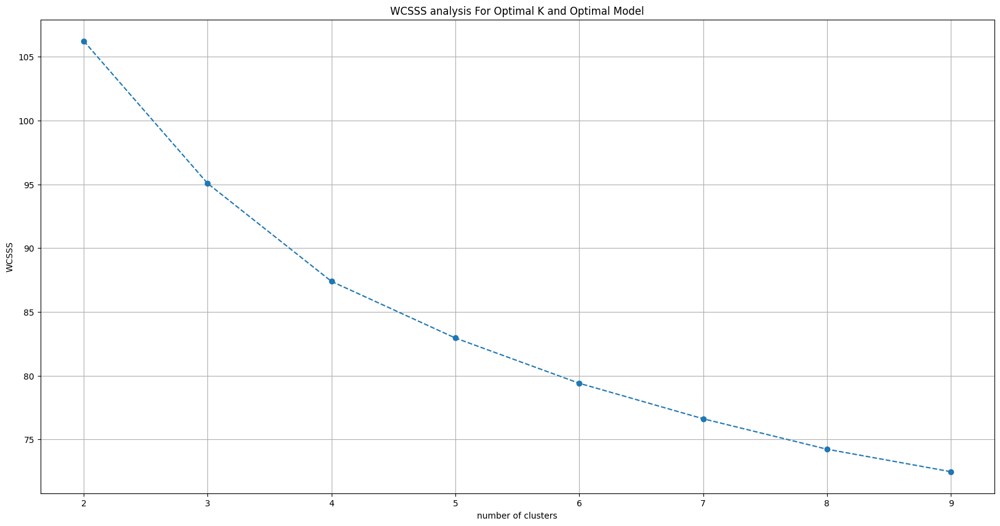

In [122]:
from scipy.signal import savgol_filter
def get_samples_dx2(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr=list(v[(v.index<offset+num_samples)&(v.index>=offset)]["Elo"])

            if len(arr)<num_samples:
                continue

            samples[p]=savgol_filter(arr,3,2)


        except Exception as err:
            print(err)
            pass
   
    
    return samples

df=pd.DataFrame.from_dict(get_samples_dx2(players_dict,50,150)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,150)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



wcss=kmeans_wcsss(X_train,"euclidean",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(4,"kmeans_euclidean0",X_train,"euclidean")



labels=kmeans_cluster(4,"kmeans_euclidean_v2_150_",X_train,"euclidean")
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open("data/lichess/dataset_raw/player_series_labels_v2_150_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,1.889261,2.301881,2.198726,2.107033,2.210188,2.301881,2.084109,1.877800,1.820492,1.717337,...,-0.322836,-0.322836,-0.231143,-0.311375,-0.242605,-0.127988,-0.208220,-0.322836,-0.391606,-0.403068
gavmo,-1.133542,-1.266963,-0.786648,-0.306334,0.147296,0.547558,0.921136,1.294714,1.294714,0.947820,...,1.454819,1.855081,1.748344,1.668292,1.588240,1.561555,1.588240,1.187978,1.187978,1.374767
AzianPowah,1.098453,1.019171,0.820966,0.761504,0.999350,1.217376,1.296658,1.138094,0.900248,0.939889,...,0.404735,0.246171,-0.269163,-0.348445,-0.031316,0.226350,0.384914,0.583119,0.880427,1.058812
Terramoto,0.896441,0.631801,0.455375,0.484780,0.440673,0.396567,0.631801,0.881738,0.984654,0.984654,...,-0.970736,-0.720799,-0.514968,-0.573777,-0.838416,-0.941331,-0.867820,-0.750203,-0.603181,-0.514968
paravion,0.503255,0.142757,-0.001442,-0.235766,-0.235766,-0.235766,-0.488114,-0.704413,-0.632313,-0.452064,...,-0.560214,-0.704413,-0.848612,-0.956761,-1.155035,-1.443434,-1.713807,-1.930106,-2.110355,-2.200479


,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,0.888545,1.000000,0.972136,0.947368,0.975232,1.000000,0.941176,0.885449,0.869969,0.842105,...,0.291022,0.291022,0.315789,0.294118,0.312693,0.343653,0.321981,0.291022,0.272446,0.269350
gavmo,0.245810,0.217877,0.318436,0.418994,0.513966,0.597765,0.675978,0.754190,0.754190,0.681564,...,0.787709,0.871508,0.849162,0.832402,0.815642,0.810056,0.815642,0.731844,0.731844,0.770950
AzianPowah,0.783333,0.761111,0.705556,0.688889,0.755556,0.816667,0.838889,0.794444,0.727778,0.738889,...,0.588889,0.544444,0.400000,0.377778,0.466667,0.538889,0.583333,0.638889,0.722222,0.772222
Terramoto,0.836000,0.764000,0.716000,0.724000,0.712000,0.700000,0.764000,0.832000,0.860000,0.860000,...,0.328000,0.396000,0.452000,0.436000,0.364000,0.336000,0.356000,0.388000,0.428000,0.452000
paravion,0.545455,0.472727,0.443636,0.396364,0.396364,0.396364,0.345455,0.301818,0.316364,0.352727,...,0.330909,0.301818,0.272727,0.250909,0.210909,0.152727,0.098182,0.054545,0.018182,0.000000


(5930, 150, 1) (5930, 150, 1)
105.46631991275167
K = 2. Took 2.80 seconds to calculate.
94.06940006239695
K = 3. Took 4.43 seconds to calculate.
86.63294577688043
K = 4. Took 3.68 seconds to calculate.
81.88461756151386
K = 5. Took 7.24 seconds to calculate.
78.28062339062541
K = 6. Took 5.82 seconds to calculate.
75.62527180364083
K = 7. Took 7.49 seconds to calculate.
72.74722144376678
K = 8. Took 7.36 seconds to calculate.
71.09679587314967
K = 9. Took 7.44 seconds to calculate.


Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

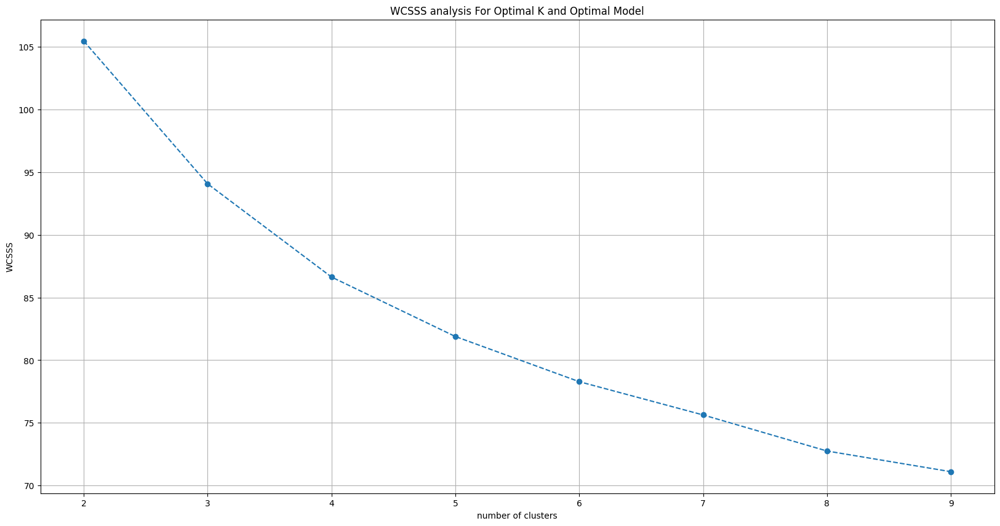

In [123]:
from scipy.signal import savgol_filter
def get_samples_dx2(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr=list(v[(v.index<offset+num_samples)&(v.index>=offset)]["Elo"])

            if len(arr)<num_samples:
                continue

            samples[p]=savgol_filter(arr,2,1)


        except Exception as err:
            print(err)
            pass
   
    
    return samples

df=pd.DataFrame.from_dict(get_samples_dx2(players_dict,50,150)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



wcss=kmeans_wcsss(X_train,"euclidean",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(4,"kmeans_euclidean1",X_train,"euclidean")

In [124]:
from scipy.optimize import curve_fit
from statsmodels.tsa.holtwinters import SimpleExpSmoothing,Holt

def get_samples_dx2(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr=(v[(v.index<offset+num_samples)&(v.index>=offset)]["Elo"])

            if len(arr)<num_samples:
                continue
            samples[p]=list(SimpleExpSmoothing(arr).fit(smoothing_level=0.2,optimized=False).fittedvalues)


        except Exception as err:
            print(err)
            pass
   
    
    return samples

df=pd.DataFrame.from_dict(get_samples_dx2(players_dict,50,150)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)





/home/ariel/anaconda3/envs/ml/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/home/ariel/anaconda3/envs/ml/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/home/ariel/anaconda3/envs/ml/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/home/ariel/anaconda3/envs/ml/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/home/ariel/anaconda3/envs/ml/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An u

,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,1.735237,1.735237,1.818909,1.877039,1.892716,1.900855,1.951403,1.983034,1.933475,1.889423,...,-0.564588,-0.509772,-0.505554,-0.462545,-0.432542,-0.434962,-0.384053,-0.352133,-0.348616,-0.367822
gavmo,-1.293578,-1.293578,-1.386363,-1.341296,-1.185948,-0.942374,-0.641474,-0.307970,0.051618,0.432074,...,0.780512,0.948914,1.202931,1.485674,1.579319,1.747019,1.748630,1.869213,1.859640,1.759197
AzianPowah,1.162766,1.162766,1.162766,1.128613,1.050062,1.012836,1.059898,1.114624,1.175481,1.138786,...,1.273801,1.072292,0.970853,0.761629,0.500330,0.351058,0.308483,0.308577,0.342804,0.421415
Terramoto,0.864821,0.864821,0.828343,0.762683,0.673677,0.651110,0.566180,0.546873,0.580064,0.661334,...,-1.350650,-1.320971,-1.242511,-1.131106,-1.005505,-0.965820,-0.982709,-0.990140,-0.971767,-0.932750
paravion,0.545070,0.545070,0.462428,0.377949,0.255272,0.092853,0.027195,-0.089608,-0.247328,-0.419416,...,-0.902557,-0.870139,-0.871753,-0.918956,-0.984266,-1.064061,-1.201356,-1.384652,-1.595566,-1.810209


,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
SujithLenin,0.925383,0.925383,0.950578,0.968082,0.972803,0.975254,0.990475,1.000000,0.985077,0.971812,...,0.232856,0.249362,0.250632,0.263583,0.272618,0.271889,0.287219,0.296831,0.297890,0.292107
gavmo,0.147050,0.147050,0.125330,0.135880,0.172246,0.229266,0.299705,0.377778,0.461956,0.551019,...,0.632588,0.672010,0.731474,0.797663,0.819585,0.858843,0.859220,0.887449,0.885208,0.861694
AzianPowah,0.845764,0.845764,0.845764,0.835267,0.811124,0.799682,0.814147,0.830968,0.849672,0.838394,...,0.879891,0.817957,0.786779,0.722473,0.642162,0.596282,0.583197,0.583226,0.593745,0.617907
Terramoto,0.919235,0.919235,0.908070,0.887972,0.860728,0.853821,0.827825,0.821915,0.832075,0.856950,...,0.241109,0.250193,0.274209,0.308308,0.346753,0.358900,0.353731,0.351456,0.357080,0.369022
paravion,0.550421,0.550421,0.531108,0.511366,0.482696,0.444740,0.429395,0.402099,0.365240,0.325024,...,0.212115,0.219691,0.219314,0.208283,0.193020,0.174372,0.142287,0.099451,0.050161,0.000000


(5930, 150, 1) (5930, 150, 1)


99.23663586681309
K = 2. Took 1.82 seconds to calculate.
86.87685704361995
K = 3. Took 7.17 seconds to calculate.
77.4027578984955
K = 4. Took 8.00 seconds to calculate.
72.23061780976795
K = 5. Took 7.81 seconds to calculate.
68.30797421988093
K = 6. Took 7.99 seconds to calculate.
65.01403314210691
K = 7. Took 8.27 seconds to calculate.
62.293718562261645
K = 8. Took 6.59 seconds to calculate.
60.33686160878432
K = 9. Took 8.39 seconds to calculate.


Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

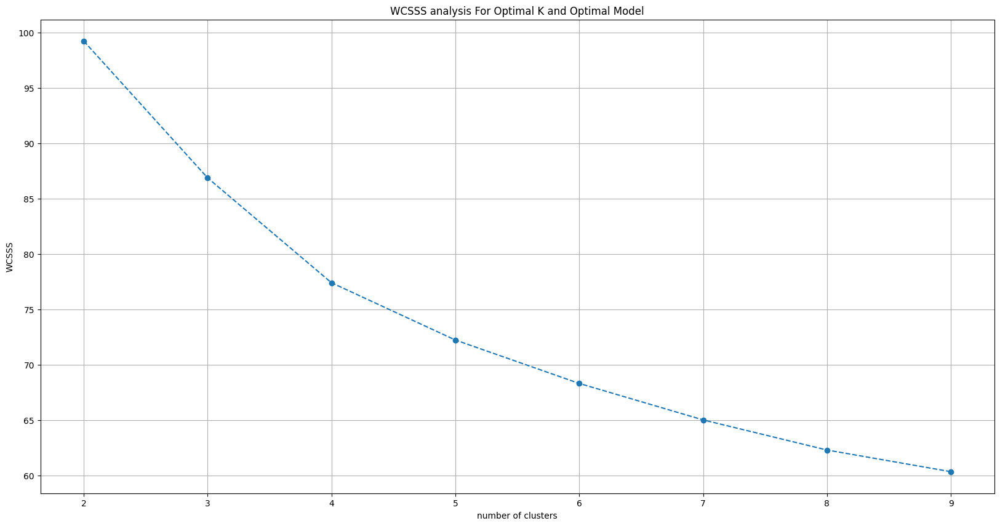

In [125]:

wcss=kmeans_wcsss(X_train,"euclidean",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")


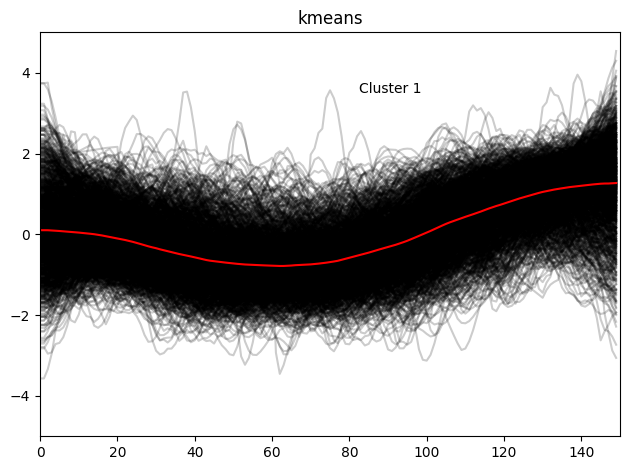

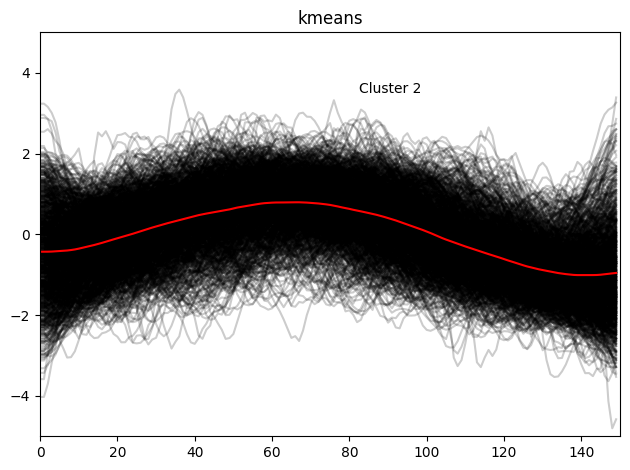

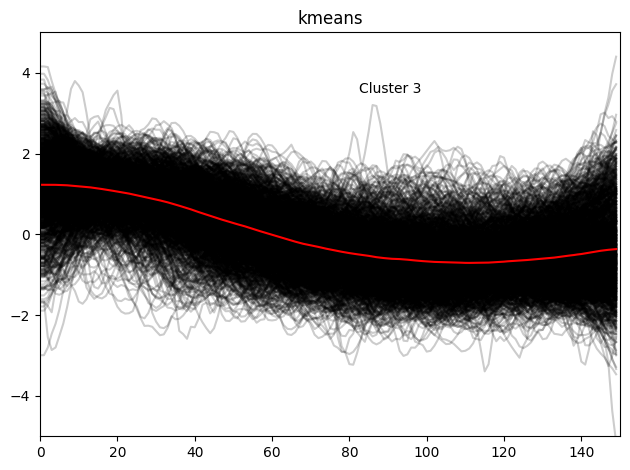

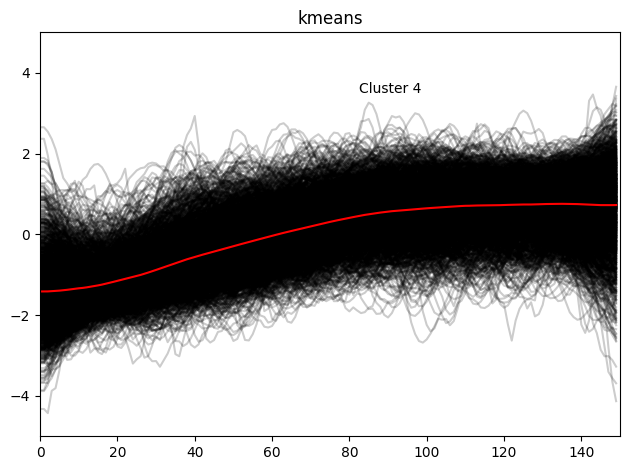

The 22.29% of the observations fall into Cluster 1
The 19.04% of the observations fall into Cluster 2
The 23.61% of the observations fall into Cluster 3
The 35.06% of the observations fall into Cluster 4
{'SujithLenin': 50     1.571210e+09
51     1.571270e+09
52     1.571270e+09
53     1.571279e+09
54     1.571354e+09
           ...     
195    1.576284e+09
196    1.576312e+09
197    1.576324e+09
198    1.576481e+09
199    1.576483e+09
Name: Timestamp, Length: 150, dtype: float64, 'gavmo': 50     1.423297e+09
51     1.423299e+09
52     1.423300e+09
53     1.423341e+09
54     1.423357e+09
           ...     
195    1.429765e+09
196    1.429768e+09
197    1.429769e+09
198    1.430117e+09
199    1.430123e+09
Name: Timestamp, Length: 150, dtype: float64, 'AzianPowah': 50     1.430158e+09
51     1.430159e+09
52     1.430160e+09
53     1.430160e+09
54     1.430208e+09
           ...     
195    1.432036e+09
196    1.432114e+09
197    1.432203e+09
198    1.432208e+09
199    1.432209e+09
Name:

In [127]:
labels=kmeans_cluster(4,"kmeans_euclidean_smooth_exp_v2_150",X_train,"euclidean")
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,150)).T

player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open("data/lichess/dataset_raw/kmeans_euclidean_smooth_exp_v2_150.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw",10)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,10),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
len(X_train)

In [ ]:
kmeans_cluster(4,"kmeans_dtw_smooth_exp",X_train,"dtw")